# Decision times data.
Collected by Jelena Grujic in YYYYYYYY


In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import math
%matplotlib inline
import hddm
print(hddm.__version__)
import numpy as np
from scipy import stats

0.6.0


/Users/eladiomontero/opt/anaconda3/envs/decTimesEnv/lib/python2.7/site-packages/IPython/parallel.py:13: ShimWarning: The `IPython.parallel` package has been deprecated since IPython 4.0. You should import from ipyparallel instead.
  "You should import from ipyparallel instead.", ShimWarning)


## Data
The data collected consists of 11 files. The parsing of the files was left as it was, each of the files were unified into a big data frame.


In [5]:
def parse_files(files_to_parse):
    o=open("output_data.dat","w")
    for index,i in enumerate(files_to_parse):
        if index==0:
            for line in open("raw data/history_"+i+".dat"):
                o.write(line.replace(" ",",").replace("usuario",i+"_usuario")) 
        else:
            f=open("raw data/history_"+i+".dat")
            f.readline()
            for line in f:
                o.write(line.replace(" ",",").replace("usuario",i+"_usuario")) 
    o.close()
    return 

files_to_parse=["s3m7","s4m8","s5m20","s6m22","s7m22","s8n3","s9n3","s10n5","s11n9","s13n12","s12n11"]
parse_files(files_to_parse)


In [6]:
data = hddm.load_csv('output_data.dat')
data.head()

,round,player,action_player,opponent,action_opponent,payoff,time_php,time_js,who_played
0,1,s3m7_usuario9,D,['s3m7_usuario18'],C,4,4480.199814,4452,user
1,1,s3m7_usuario18,C,['s3m7_usuario9'],D,0,9472.300053,9443,user
2,1,s3m7_usuario7,C,['s3m7_usuario10'],C,3,2238.199949,2213,user
3,1,s3m7_usuario10,C,['s3m7_usuario7'],C,3,8133.699894,8101,user
4,1,s3m7_usuario13,C,['s3m7_usuario5'],C,3,5098.500013,5043,user


In [7]:
session = data["player"].str.split("_", n = 1, expand = True)
data["session"] = session[0]
data.head()

,round,player,action_player,opponent,action_opponent,payoff,time_php,time_js,who_played,session
0,1,s3m7_usuario9,D,['s3m7_usuario18'],C,4,4480.199814,4452,user,s3m7
1,1,s3m7_usuario18,C,['s3m7_usuario9'],D,0,9472.300053,9443,user,s3m7
2,1,s3m7_usuario7,C,['s3m7_usuario10'],C,3,2238.199949,2213,user,s3m7
3,1,s3m7_usuario10,C,['s3m7_usuario7'],C,3,8133.699894,8101,user,s3m7
4,1,s3m7_usuario13,C,['s3m7_usuario5'],C,3,5098.500013,5043,user,s3m7


## Sessions
There are three sessions in the data, playing Prisoner's Dilemma (PD): <br>
PD with changing partners&emsp;   9600 rows, 96 players <br>
PD fixed partners&emsp;       5800 rows, 58 players<br>
Weak PD, fixed partners&emsp;       1800 rows, 18 players


In [8]:
data["treatment"] = ""
data.loc[data["session"].isin(['s1m5','s2m5','s4m8','s8n3','s9n3','s10n5']), 'treatment'] = "fix"
data.loc[data["session"].isin(['s5m20','s6m22','s7m22','s11n9','s12n11','s13n12']), 'treatment'] = "changing"
data.loc[data["session"].isin(['s3m7']), 'treatment'] = "weak"

data.head()

,round,player,action_player,opponent,action_opponent,payoff,time_php,time_js,who_played,session,treatment
0,1,s3m7_usuario9,D,['s3m7_usuario18'],C,4,4480.199814,4452,user,s3m7,weak
1,1,s3m7_usuario18,C,['s3m7_usuario9'],D,0,9472.300053,9443,user,s3m7,weak
2,1,s3m7_usuario7,C,['s3m7_usuario10'],C,3,2238.199949,2213,user,s3m7,weak
3,1,s3m7_usuario10,C,['s3m7_usuario7'],C,3,8133.699894,8101,user,s3m7,weak
4,1,s3m7_usuario13,C,['s3m7_usuario5'],C,3,5098.500013,5043,user,s3m7,weak


In [9]:
data["treatment"].value_counts()

changing    9600
fix         5800
weak        1800
Name: treatment, dtype: int64

## Other variables and other formatting

Changing the names of the variables, changing the format of their response to 1 for cooperation and 0 for defection. This was made for the hddm package. Also the response times are transformed to seconds, and for the convention the response times are negative for defection responses.

Also the "actions" column to find the cooperative/defective rounds.

There is a filtering done on keeping the responses that take less than 20 seconds, is this for a reason? Maybe recording errors?

In [10]:
#only user (not autom) and delete "who played"
data=data[data["who_played"]=="user"]
del data["who_played"]

#rename for rt and response columns
data.rename(columns={'time_js':'rt', "action_player":"response"}, inplace=True) 

#make rt floats
data['rt'] = data.rt.astype(int)

#coop is 1, defl is 0
data.loc[data['response'] == "C", "response"] = 1.0
data.loc[data['response'] == "D", "response"] = 0.0
data.loc[data['action_opponent'] == "C", "action_opponent"] = 1.0
data.loc[data['action_opponent'] == "D", "action_opponent"] = 0.0

#add strategy
data["actions"]=[str(data["response"][i])+str(data["action_opponent"][i]) for i in range(len(data))]

#rt in seconds
data["rt"]=data["rt"]/1000

#rt which are defect become neg
data = hddm.utils.flip_errors(data)
#data.rename(columns={"player":"subj_idx"},inplace=True)

data2=data.copy()
data2.rename(columns={"player":"subj_idx"},inplace=True)

#data=data[(data["rt"]<=20) & (data["rt"]>=-20)]
data.head()


,round,player,response,opponent,action_opponent,payoff,time_php,rt,session,treatment,actions
0,1,s3m7_usuario9,0,['s3m7_usuario18'],1,4,4480.199814,-4.452,s3m7,weak,01
1,1,s3m7_usuario18,1,['s3m7_usuario9'],0,0,9472.300053,9.443,s3m7,weak,10
2,1,s3m7_usuario7,1,['s3m7_usuario10'],1,3,2238.199949,2.213,s3m7,weak,11
3,1,s3m7_usuario10,1,['s3m7_usuario7'],1,3,8133.699894,8.101,s3m7,weak,11
4,1,s3m7_usuario13,1,['s3m7_usuario5'],1,3,5098.500013,5.043,s3m7,weak,11


In [11]:
#Players per game
print(len(set(data[data.treatment == "weak"].player)))
print(len(set(data[data.treatment == "changing"].player)))
print(len(set(data[data.treatment == "fix"].player)))

18
96
58


In [12]:
#Rounds
print(np.max(data[data.treatment == "weak"]["round"]))
print(np.max(data[data.treatment == "changing"]["round"]))
print(np.max(data[data.treatment == "fix"]["round"]))

100
100
100


In [13]:
data.head() #data2 will be used to plot by player

,round,player,response,opponent,action_opponent,payoff,time_php,rt,session,treatment,actions
0,1,s3m7_usuario9,0,['s3m7_usuario18'],1,4,4480.199814,-4.452,s3m7,weak,01
1,1,s3m7_usuario18,1,['s3m7_usuario9'],0,0,9472.300053,9.443,s3m7,weak,10
2,1,s3m7_usuario7,1,['s3m7_usuario10'],1,3,2238.199949,2.213,s3m7,weak,11
3,1,s3m7_usuario10,1,['s3m7_usuario7'],1,3,8133.699894,8.101,s3m7,weak,11
4,1,s3m7_usuario13,1,['s3m7_usuario5'],1,3,5098.500013,5.043,s3m7,weak,11


In [14]:
data.shape

(17200, 11)

In [15]:
fixed = data[data.treatment == "fix"]
changing = data[data.treatment == "changing"]
weak = data[data.treatment == "weak"]
weak.head()

,round,player,response,opponent,action_opponent,payoff,time_php,rt,session,treatment,actions
0,1,s3m7_usuario9,0,['s3m7_usuario18'],1,4,4480.199814,-4.452,s3m7,weak,01
1,1,s3m7_usuario18,1,['s3m7_usuario9'],0,0,9472.300053,9.443,s3m7,weak,10
2,1,s3m7_usuario7,1,['s3m7_usuario10'],1,3,2238.199949,2.213,s3m7,weak,11
3,1,s3m7_usuario10,1,['s3m7_usuario7'],1,3,8133.699894,8.101,s3m7,weak,11
4,1,s3m7_usuario13,1,['s3m7_usuario5'],1,3,5098.500013,5.043,s3m7,weak,11


In [16]:
fixed_s = data2[data2.treatment == "fix"]
changing_s = data2[data2.treatment == "changing"]
weak_s = data2[data2.treatment == "weak"]

## Data analysis

First, I wanted to see an overview of the users' actions per game. Looking at all the games together seemed a bit naive to me, since the response times, cooperation rate differ per game.

### Users' actions

The different actions per game. (A plot is missing here), but in the changing setting the defection is high and in the fixed the cooperation is higher.

Also, trying to see the evolution of cooperation per round, they start sort of the same rate but the weak has the most cooperation rate, followed by the fixed partners and then the changing partners game.

In [17]:
key = ["treatment", "actions"]
game_counts = data[["treatment", "actions", "round"]].groupby(key).count()
game_counts = game_counts.reset_index()

game_counts

,treatment,actions,round
0,changing,00,4934
1,changing,01,1928
2,changing,10,1928
3,changing,11,810
4,fix,00,1836
5,fix,01,616
6,fix,10,616
7,fix,11,2732
8,weak,00,108
9,weak,01,93


In [18]:
counts = fixed.groupby(["round", "actions"]).size() 
rounds = fixed.groupby(["round"]).size() 
rates_fix = counts.div(rounds, level='round') 
rates_fix = rates_fix.to_frame(name = 'count').reset_index()

counts = changing.groupby(["round", "actions"]).size() 
rounds = changing.groupby(["round"]).size() 
rates_ch = counts.div(rounds, level='round') 
rates_ch = rates_ch.to_frame(name = 'count').reset_index()

counts = weak.groupby(["round", "actions"]).size() 
rounds = weak.groupby(["round"]).size() 
rates_we = counts.div(rounds, level='round')
rates_we = rates_we.to_frame(name = 'count').reset_index()

In [19]:
coop_fix = rates_fix[rates_fix.actions == "11"]
coop_ch = rates_ch[rates_ch.actions == "11"]
coop_we = rates_we[rates_we.actions == "11"]


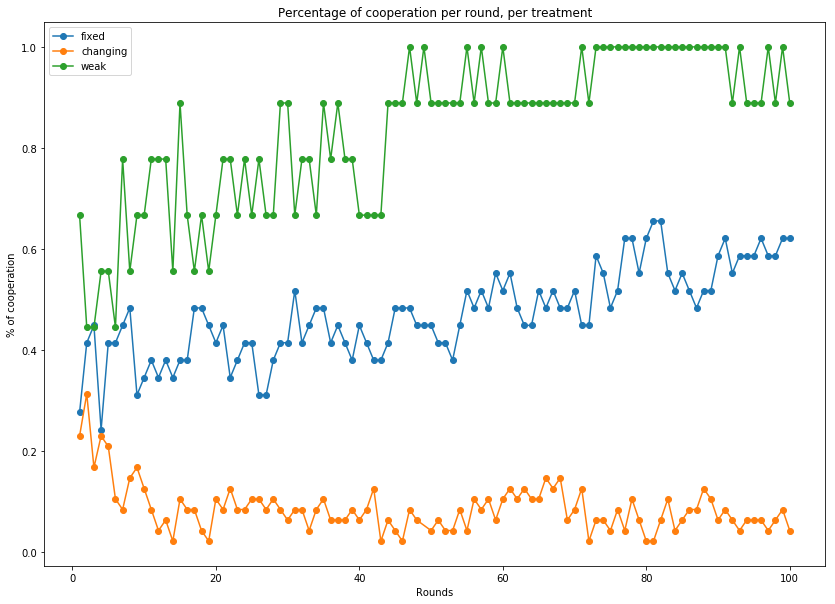

In [20]:
plt.figure(figsize = (14,10))
plt.plot(coop_fix['round'], coop_fix['count'], '-o', label = "fixed" )
plt.plot(coop_ch['round'], coop_ch['count'], '-o', label = "changing")
plt.plot(coop_we['round'], coop_we['count'], '-o', label = "weak")
plt.xlabel("Rounds")
plt.title("Percentage of cooperation per round, per treatment")
plt.ylabel("% of cooperation")
plt.legend()

### Response times

Looking at all the games, most of the response time is concentrated in 5 seconds or less. The average response time in both fixed and changing partners of PD is around 2.4 seconds for both strategies with a similar standard deviation, however for weak PD the average response time is 3.3 seconds for defection and 1.3 for cooperation, with a smaller standard deviation.

In the last figure I plotted the RT per round (mean) and they all seem to take the same amount of time, but after round 20, 30, it starts to settle.

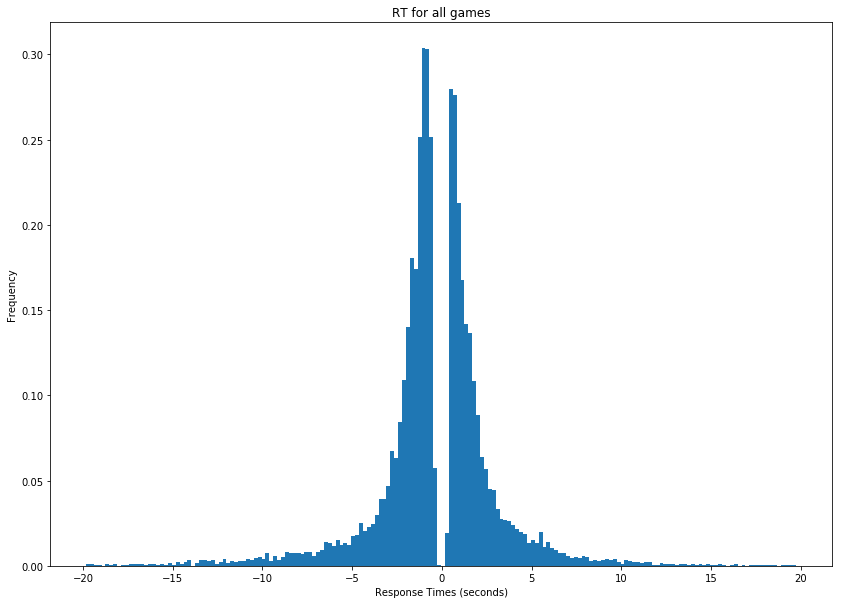

In [141]:
plt.figure(figsize = (14,10))
plt.hist(data.rt, density = True, bins = "auto")
plt.xlabel("Response Times (seconds)")
plt.ylabel("Frequency")
plt.title("RT for all treatments")
plt.show()

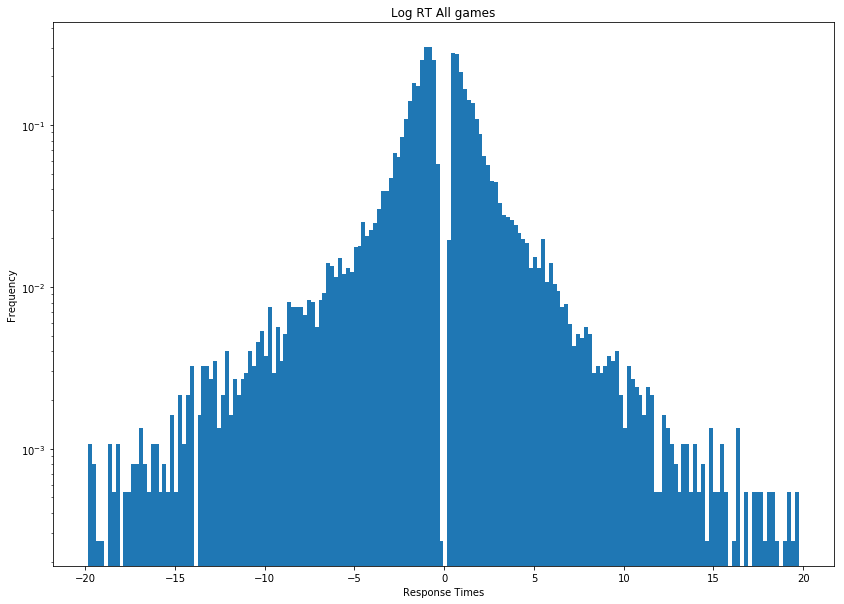

In [19]:
plt.figure(figsize = (14,10))
plt.hist(data.rt, density = True, bins = "auto", log=True)
plt.xlabel("Response Times")
plt.ylabel("Frequency")
plt.title("Log RT All games")
plt.show()

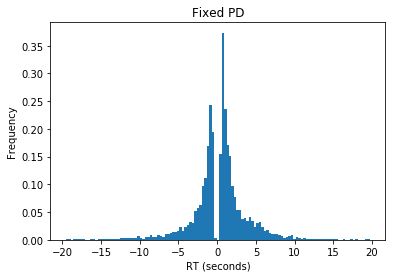

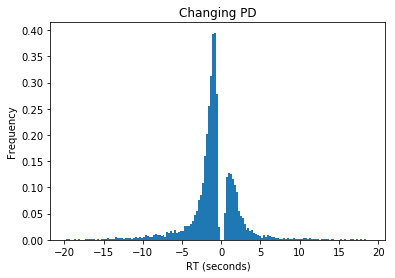

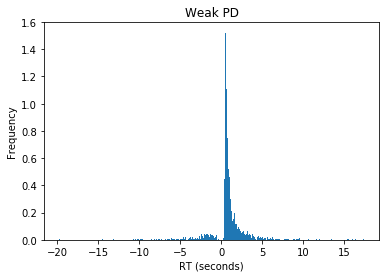

In [142]:
#Per treatment
plt.title("Fixed PD")
plt.hist(fixed.rt, density = True, bins = "auto")
plt.xlabel("RT (seconds)")
plt.ylabel("Frequency")
plt.show()

plt.title("Changing PD")
plt.hist(changing.rt, density = True, bins = "auto")
plt.xlabel("RT (seconds)")
plt.ylabel("Frequency")
plt.show()

plt.title("Weak PD")
plt.hist(weak.rt, density = True, bins = "auto")
plt.xlabel("RT (seconds)")
plt.ylabel("Frequency")
plt.show()

Text(0.5,1,'Response time, All treatments')

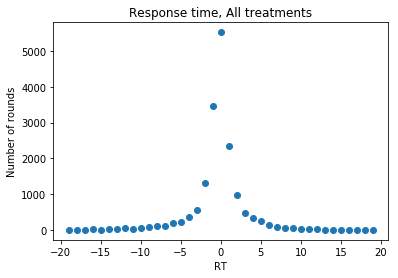

In [21]:
#plotting PDF of the reaction times
times = data.rt.astype(int)
times = np.append(times, 0)
x ,y  = np.unique(times, return_counts=True)

plt.scatter(x,y)
plt.xlabel("RT")
plt.ylabel("Number of rounds")
plt.title("Response time, All treatments")

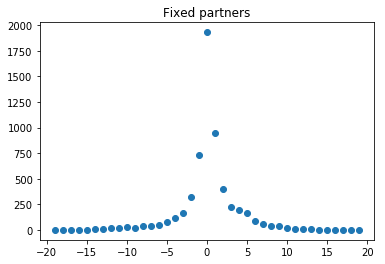

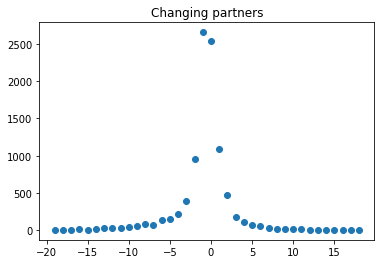

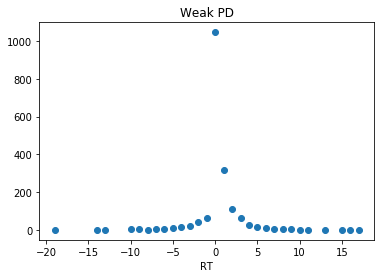

In [22]:
#THESE ARE MISLEADING
#plotting PDF of the reaction times for fixed
times = fixed.rt.astype(int)
times = np.append(times, 0)
fixed_x ,fixed_y  = np.unique(times, return_counts=True)
plt.scatter(fixed_x,fixed_y)
plt.title("Fixed partners")
plt.show()

times = changing.rt.astype(int)
times = np.append(times, 0)
chang_x ,chang_y  = np.unique(times, return_counts=True)
plt.scatter(chang_x,chang_y)
plt.title("Changing partners")
plt.show()

times = weak.rt.astype(int)
times = np.append(times, 0)
weak_x ,weak_y  = np.unique(times, return_counts=True)
plt.scatter(weak_x,weak_y)
plt.title("Weak PD")
plt.xlabel("RT")
plt.show()

In [23]:
key = ["treatment", "response"]
print data[["treatment", "response", "rt"]].groupby(key).mean()
print data[["treatment", "response", "rt"]].groupby(key).std()


                          rt
treatment response          
changing  0        -2.310879
          1         2.415314
fix       0        -2.559468
          1         2.405402
weak      0        -3.312045
          1         1.314269
                          rt
treatment response          
changing  0         2.548093
          1         2.494136
fix       0         2.825090
          1         2.463911
weak      0         2.829741
          1         1.630633


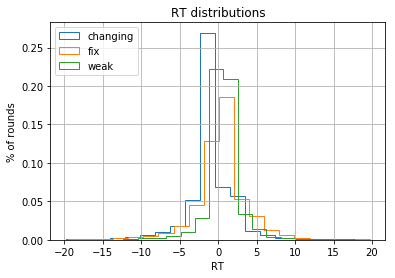

In [21]:
fig = plt.figure()
ax = fig.add_subplot(111, xlabel='RT', ylabel='% of rounds', title='RT distributions')
for i, subj_data in data.groupby('treatment'):
    subj_data.rt.hist(bins=20, histtype='step', ax=ax, label = i, density = True)
plt.legend(loc="upper left")

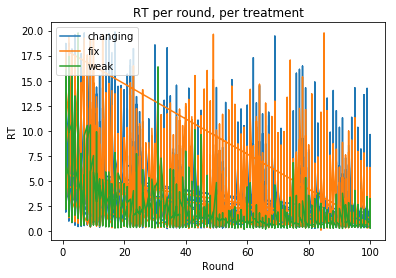

In [22]:
#Plotting response times per round, per treatment
fig = plt.figure()
ax = fig.add_subplot(111, xlabel='Round', ylabel='RT', title='RT per round, per treatment')
for i, subj_data in data.groupby('treatment'):
    plt.errorbar(subj_data["round"], np.abs(subj_data.rt), label = i)
plt.legend(loc="upper left")

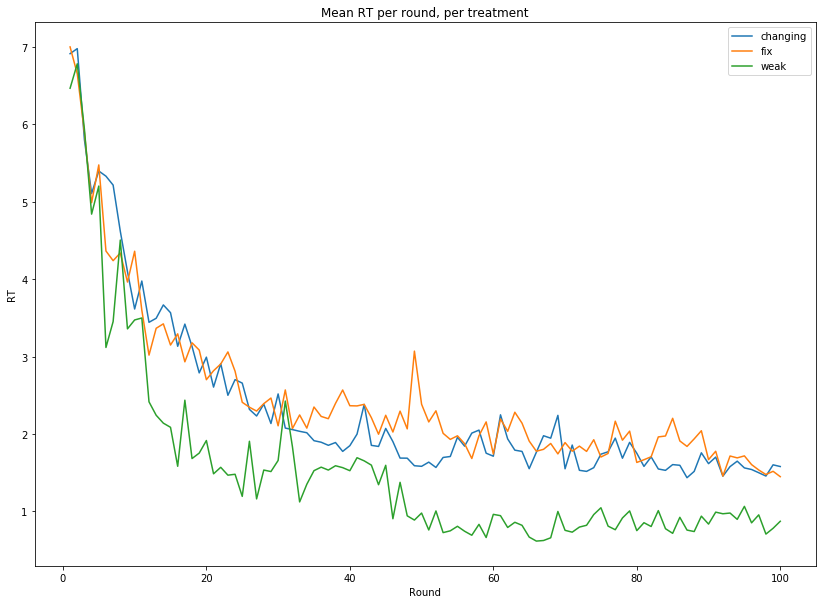

In [144]:
plt.figure(figsize = (14,10))
for i, subj_data in data.groupby('treatment'):
    subj_data.rt = subj_data.rt.abs()
    means = subj_data[['round', 'rt']].groupby("round").mean()
    plt.plot(means, label = i)


plt.title("Mean RT per round, per treatment")
plt.ylabel("RT")
plt.xlabel("Round")
plt.legend(loc = "best")

# HDDM Model

Using the HDDM package (which is only available for Python 2.7, afaik) each of the games were tested. 

This model uses three main variables: threshold a, drift v, time t, and bias z.

(Taken from the model package documentation) http://ski.clps.brown.edu/hddm_docs/methods.html

<img src="images/DDM.svg">



a: The threshold a is a measure that separates each of the boundaries of both decisions. Graphically, are the top and bottom lines where each decision converges. It reduces everytime when the perceived difficulty of the decision decreases and less evidence needs to be accumulated to get a response. "Narrower threshold makes the decision process faster but introduces more noise in the process".

v: The drift speed will determine the evidence accumulation process towards either decision. In the first round of a game the drift speed is zero, since there is no information "to consider for a rational deliberation" (from Riccardo and Jelena's paper). This speed will vary between rounds due to the difficulty of the task and the noise in the drift process.

t: The response time of a given decision process. The model takes into account the so-called non-decision time (t0). "Corresponds to the time before the decisions process starts to happen" and it's linked to the human reaction time of realizing there is a new round or the time it takes for an user to press the right button.

z: The bias tells us about the initial inclination of the user to take either one of the two (what is there is more than two) options. For example, in the paper the cooperation rate is calculated in the first round to be around 60%, which goes in line with humans' desire for cooperation (source needed)

# Tests  


In [250]:
#basic model for all games
m = hddm.HDDM(data)
# find a good starting point which helps with the convergence.
m.find_starting_values()
m.sample(2000, burn=20)


-40653.8129954
-40653.439544
 [-----------------100%-----------------] 2000 of 2000 complete in 110.2 sec

In [251]:
#get statistics from a t and v
stats = m.gen_stats()
#stats[stats.index.isin(['a', "t", 'v'])]
stats

,mean,std,2.5q,25q,50q,75q,97.5q,mc err
a,2.94062,0.0104081,2.91982,2.93336,2.94089,2.94774,2.96073,0.000281417
v,-0.0699544,0.0049675,-0.07994,-0.0732522,-0.0698652,-0.0666699,-0.0604736,0.000107876
t,0.0836627,0.00464428,0.0744512,0.0806479,0.0837385,0.0867839,0.09263,0.000140306


In [252]:
m_fixed = hddm.HDDM(fixed)
m_fixed.find_starting_values()
m_fixed.sample(2000, burn = 20) #I still have to understand this a bit better 


-14214.851756
-14214.7507154
 [-----------------100%-----------------] 2000 of 2000 complete in 36.1 sec

In [253]:
stats_fixed = m_fixed.gen_stats()
stats_fixed

,mean,std,2.5q,25q,50q,75q,97.5q,mc err
a,3.06225,0.0182139,3.02677,3.04987,3.06278,3.07479,3.09692,0.000573698
v,0.0995744,0.00869237,0.0819395,0.0938808,0.0996896,0.105459,0.116049,0.00018987
t,0.053836,0.00852005,0.0373496,0.0479747,0.0540665,0.0597783,0.0704263,0.00027562


In [370]:
m_changing = hddm.HDDM(changing)
m_changing.find_starting_values()
m_changing.sample(2000, burn = 20)


-21706.9268799
-21706.926849
 [-----------------100%-----------------] 2000 of 2000 complete in 62.1 sec

In [255]:
stats_changing = m_changing.gen_stats()
stats_changing

,mean,std,2.5q,25q,50q,75q,97.5q,mc err
a,3.04021,0.0151939,3.01174,3.02956,3.0399,3.05031,3.07119,0.000495367
v,-0.295435,0.00710328,-0.309919,-0.300244,-0.295395,-0.290657,-0.281588,0.000168601
t,0.125432,0.00655228,0.112848,0.120786,0.125388,0.130065,0.138093,0.000214431


In [367]:
m_weak = hddm.HDDM(weak)
m_weak.find_starting_values()
m_weak.sample(2000, burn = 20)

-2911.95284945
-2911.89648305
 [-----------------100%-----------------] 2000 of 2000 complete in 11.7 sec

In [257]:
stats_weak = m_weak.gen_stats()
stats_weak

,mean,std,2.5q,25q,50q,75q,97.5q,mc err
a,2.64592,0.0349461,2.57873,2.62141,2.64528,2.67001,2.71346,0.00142493
v,0.70184,0.021174,0.660544,0.687921,0.702235,0.716517,0.743508,0.000550219
t,0.0714218,0.0119456,0.0472524,0.0636839,0.0720032,0.0790954,0.0945701,0.000472368


## Second test 

We found out that we were leaving the parameters fixed over all subjects and all rounds.

So we're training a model for each treatment and every parameter changing for each round.

In [402]:
m_weak_s2 = hddm.HDDM(weak_s, bias = True, depends_on = {'a': 'round','z': 'round','v': 'round','t': 'round'})
m_weak_s2.find_starting_values()
m_weak_s2.sample(1000, burn = 20)

 [-----------------100%-----------------] 1001 of 1000 complete in 7181.4 sec

In [406]:
m_chang_s2 = hddm.HDDM(changing_s, bias = True, depends_on = {'a': 'round','z': 'round','v': 'round','t': 'round'})
m_chang_s2.find_starting_values()
m_chang_s2.sample(1000, burn = 20)

 [-----------------100%-----------------] 1001 of 1000 complete in 25050.2 sec

In [407]:
m_fix_s2 = hddm.HDDM(fixed_s, bias = True, depends_on = {'a': 'round','z': 'round','v': 'round','t': 'round'})
m_fix_s2.find_starting_values()
m_fix_s2.sample(1000, burn = 20)

 [-----------------100%-----------------] 1001 of 1000 complete in 11989.7 sec

In [403]:
stats = m_weak_s2.gen_stats()

In [408]:
stats_c = m_chang_s2.gen_stats()
stats_f = m_fix_s2.gen_stats()

In [410]:
#stats.index.name = 'parameter'
#stats.reset_index(inplace=True)

stats_c.index.name = 'parameter'
stats_c.reset_index(inplace=True)

stats_f.index.name = 'parameter'
stats_f.reset_index(inplace=True)
stats_f

,parameter,mean,std,2.5q,25q,50q,75q,97.5q,mc err
0,a(1),5.57694,0.507233,4.6941,5.26725,5.58375,5.88295,6.58602,0.0440224
1,a(2),5.55959,0.587979,3.87722,5.29178,5.62491,5.948,6.43856,0.0550856
2,a(3),4.84965,0.395852,4.11534,4.61519,4.84288,5.0925,5.57403,0.0330327
3,a(4),4.62546,0.407383,3.66372,4.42258,4.64349,4.86277,5.3521,0.0358453
4,a(5),4.84976,0.451374,3.7573,4.61651,4.85709,5.13004,5.72306,0.0416285
5,a(6),4.11619,0.439356,3.33351,3.80092,4.07615,4.38984,5.10444,0.0400448
6,a(7),3.98515,0.319479,3.30139,3.79884,4.01009,4.19689,4.53415,0.0244594
7,a(8),4.14956,0.365763,3.08558,3.9531,4.16292,4.38667,4.77898,0.029941
8,a(9),3.87516,0.294473,3.19839,3.70845,3.88996,4.06009,4.38231,0.0225026
9,a(10),4.34963,0.338846,3.52012,4.16587,4.37027,4.5596,4.92478,0.0282808


## Third tests

Two models per treatment. One for the subjects, and the second one for rounds.

In [182]:
def fit_model(data, size, burn, intertrial = False):
    #Fitting model
    if intertrial:
        model = hddm.HDDM(data, bias = True, include=('sv', 'st', 'sz'))
    else:
        model = hddm.HDDM(data, bias = True)
    model.find_starting_values()
    model.sample(size, burn = burn)
    model.plot_posteriors()
    #Getting stats
    stats_df = model.gen_stats()
    stats_df.index.name = 'parameter'
    stats_df.reset_index(inplace=True)
    #Formatting stats
    new = stats_df["parameter"].str.split("_subj.", n = 1, expand = True) 
    # making separate first name column from new data frame 
    stats_df["param"]= new[0] 

    # making separate last name column from new data frame 
    stats_df["subject"]= new[1] 

    # Dropping old Name columns 
    stats_df.drop(columns =["parameter"], inplace = True)
    #stats_df = stats_df.dropna()
    return stats_df


In [147]:
def plot_params(stats_df, title):
    parameters = ["a", "v", "z", "t"]
    fig, axs = plt.subplots(4, 4)
    fig.set_size_inches(13,13) 
    fig.suptitle('Correlation plots with Pearson coefficient, %s, (subjects model)' % (title), fontsize=16)
    i = 0
    j = 0
    for p2 in parameters:
        j = 0
        for p in parameters:
            x = stats_df.loc[stats_df.param == p, "mean"]
            y = stats_df.loc[stats_df.param == p2, "mean"]
            axs[i,j].scatter(x, y)
            axs[i,j].set_title("Corr: %f, p value: %s" % (np.round(stats.pearsonr(x,y)[0], 2), np.round(stats.pearsonr(x,y)[1], 4)))
            j = j + 1
        i = i + 1

    axs.flat[0].set(ylabel='a')
    axs.flat[4].set(ylabel='v')
    axs.flat[8].set(ylabel='z')
    axs.flat[12].set(ylabel='t')

    axs.flat[12].set(xlabel='a')
    axs.flat[13].set(xlabel='v')
    axs.flat[14].set(xlabel='z')
    axs.flat[15].set(xlabel='t')

In [24]:
m_fix_3 = hddm.HDDM(fixed_s, bias = True)
m_fix_3.find_starting_values()
m_fix_3.sample(1000, burn = 20)

/Users/eladiomontero/opt/anaconda3/envs/decTimesEnv/lib/python2.7/site-packages/scipy/optimize/optimize.py:1934: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/Users/eladiomontero/opt/anaconda3/envs/decTimesEnv/lib/python2.7/site-packages/scipy/optimize/optimize.py:1935: RuntimeWarning: invalid value encountered in double_scalars
  p = (x - v) * tmp2 - (x - w) * tmp1


 [-----------------100%-----------------] 1000 of 1000 complete in 84.5 sec

In [25]:
m_chang_3 = hddm.HDDM(changing_s, bias = True)
m_chang_3.find_starting_values()
m_chang_3.sample(1000, burn = 20)

 [-----------------100%-----------------] 1001 of 1000 complete in 140.5 sec

In [26]:
m_weak_3 = hddm.HDDM(weak_s, bias = True)
m_weak_3.find_starting_values()
m_weak_3.sample(1000, burn = 20)

 [-----------------100%-----------------] 1000 of 1000 complete in 21.1 sec

In [27]:
stats_u_c = m_fix_3.gen_stats()
stats_u_f = m_chang_3.gen_stats()
stats_u_w = m_weak_3.gen_stats()

#stats.index.name = 'parameter'
#stats.reset_index(inplace=True)

stats_u_c.index.name = 'parameter'
stats_u_c.reset_index(inplace=True)

stats_u_f.index.name = 'parameter'
stats_u_f.reset_index(inplace=True)

stats_u_w.index.name = 'parameter'
stats_u_w.reset_index(inplace=True)

In [28]:
new = stats_u_c["parameter"].str.split("_subj.", n = 1, expand = True) 
  
# making separate first name column from new data frame 
stats_u_c["param"]= new[0] 
  
# making separate last name column from new data frame 
stats_u_c["round"]= new[1] 
  
# Dropping old Name columns 
stats_u_c.drop(columns =["parameter"], inplace = True)

In [29]:
new = stats_u_w["parameter"].str.split("_subj.", n = 1, expand = True) 
  
# making separate first name column from new data frame 
stats_u_w["param"]= new[0] 
  
# making separate last name column from new data frame 
stats_u_w["round"]= new[1] 
  
# Dropping old Name columns 
stats_u_w.drop(columns =["parameter"], inplace = True)

In [30]:
new = stats_u_f["parameter"].str.split("_subj.", n = 1, expand = True) 
  
# making separate first name column from new data frame 
stats_u_f["param"]= new[0] 
  
# making separate last name column from new data frame 
stats_u_f["round"]= new[1] 
  
# Dropping old Name columns 
stats_u_f.drop(columns =["parameter"], inplace = True)

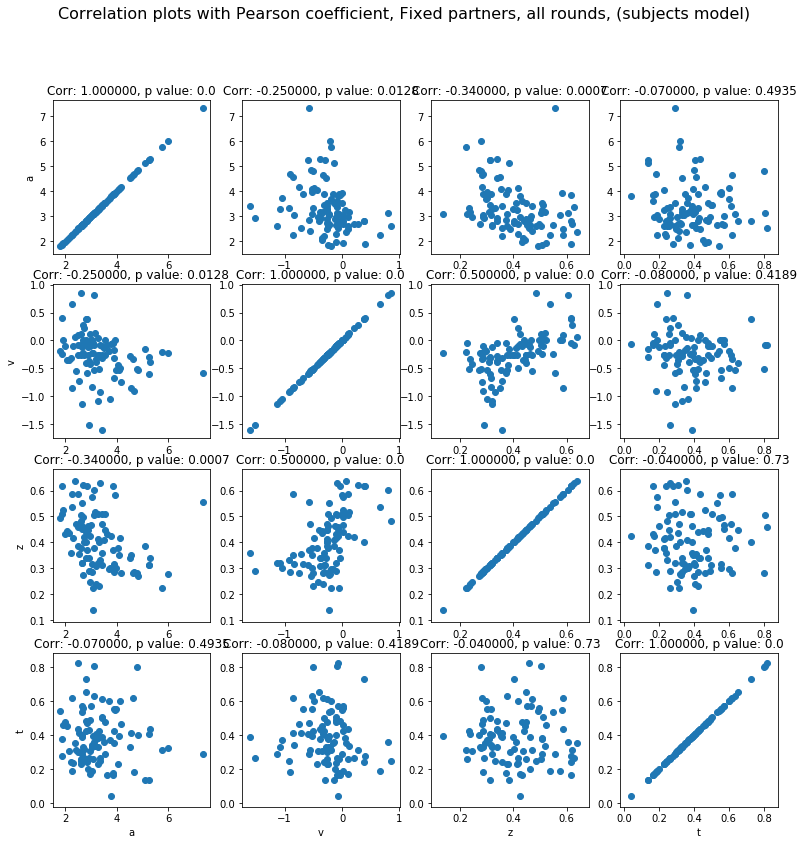

In [148]:
plot_params(stats_u_f, "Fixed partners, all rounds")

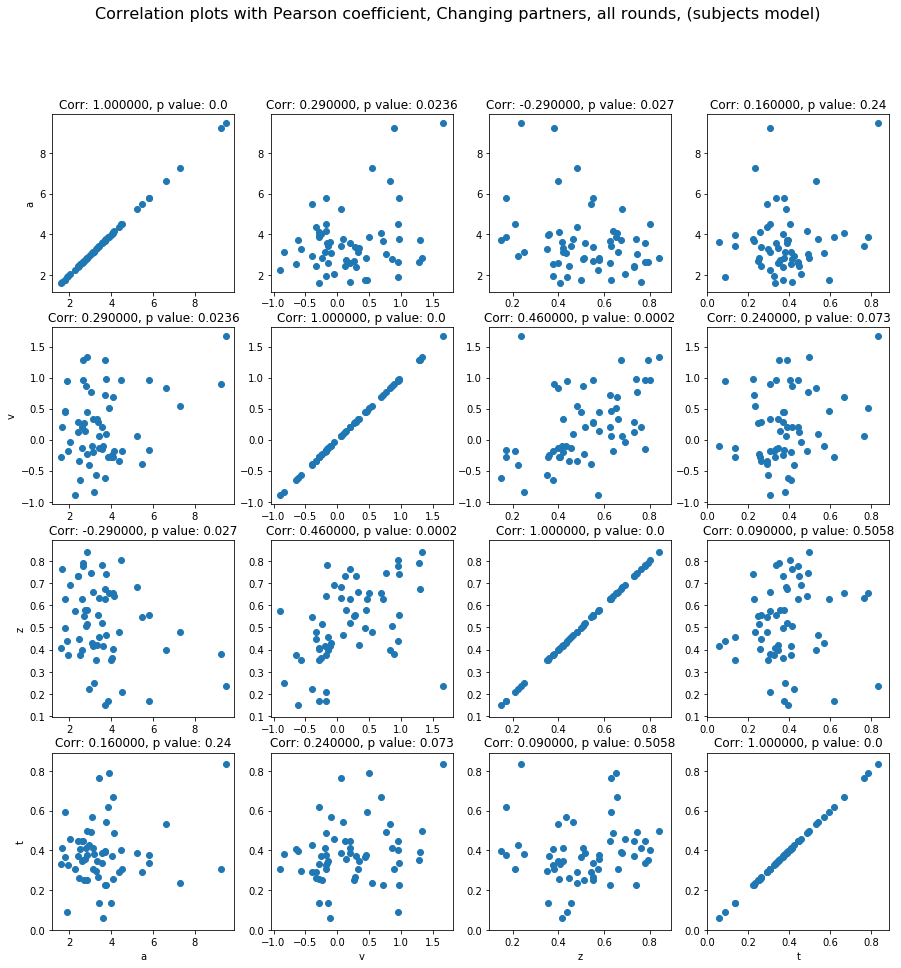

In [63]:
plot_params(stats_u_c, "Changing partners, all rounds")

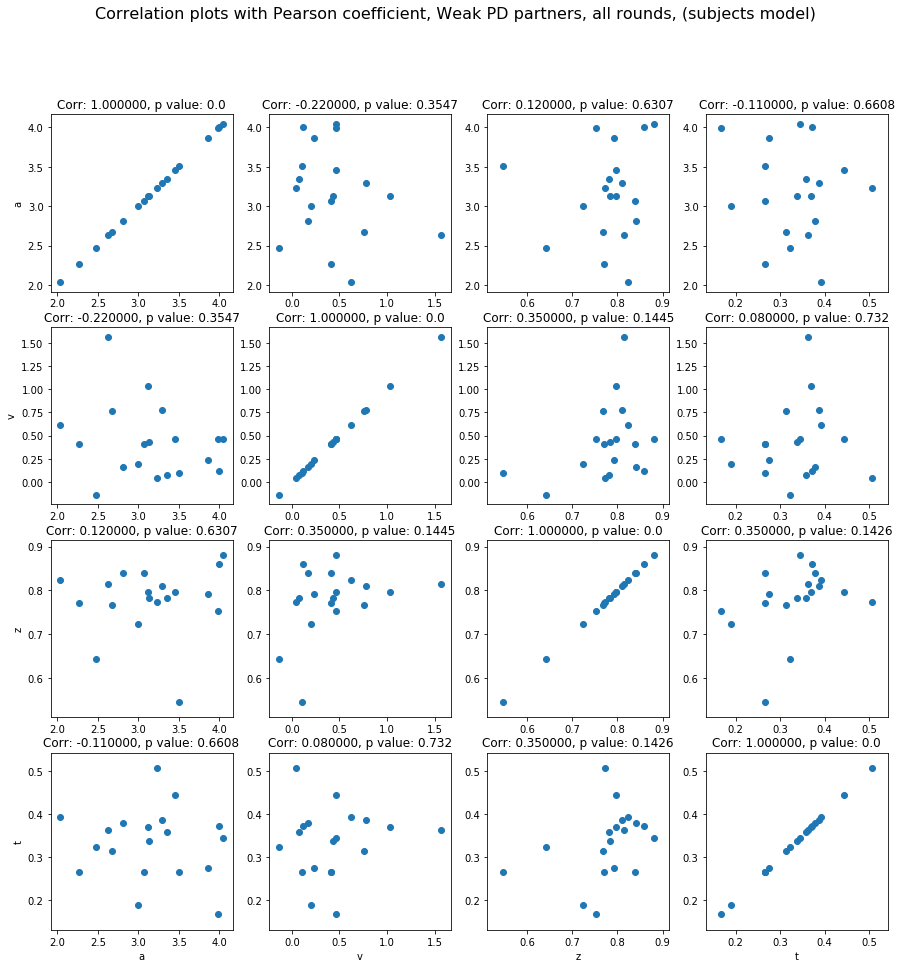

In [64]:
plot_params(stats_u_w, "Weak PD partners, all rounds")

Plotting a
Plotting a_std
Plotting v
Plotting v_std
Plotting t
Plotting t_std
Plotting z
Plotting z_std


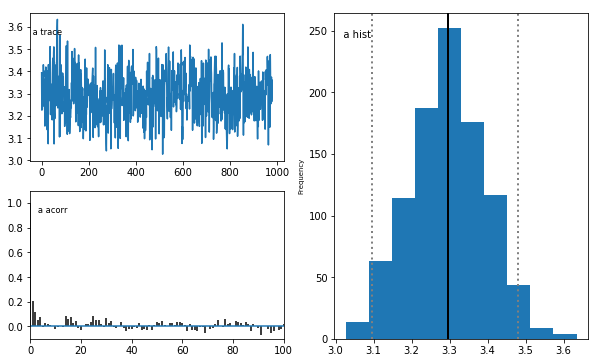

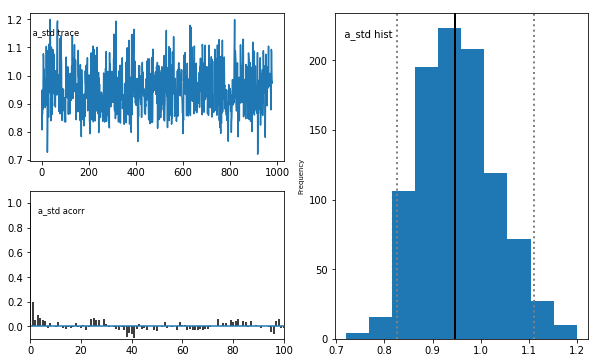

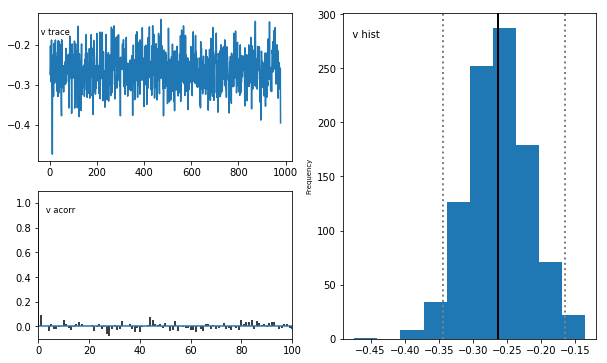

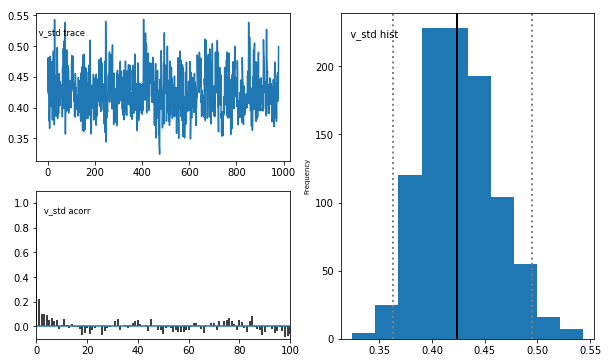

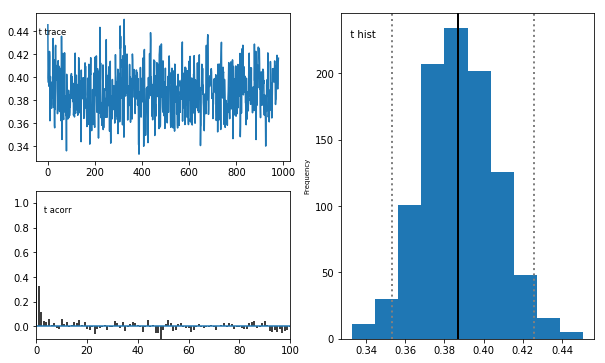

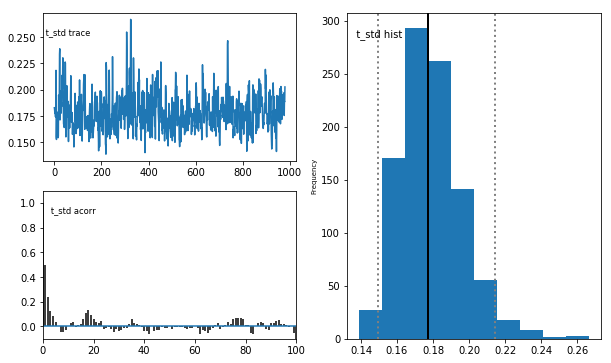

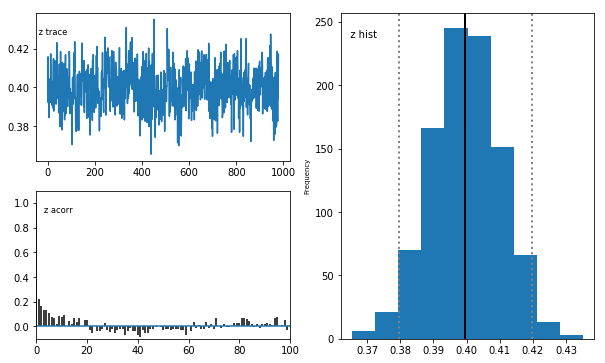

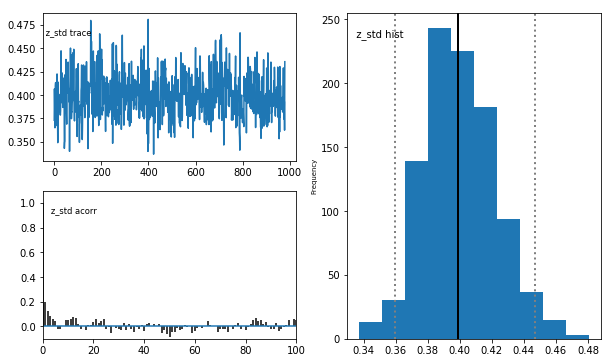

In [36]:
#Testing convergence
m_chang_3.plot_posteriors()

Plotting a
Plotting a_std
Plotting v
Plotting v_std
Plotting t
Plotting t_std
Plotting z
Plotting z_std


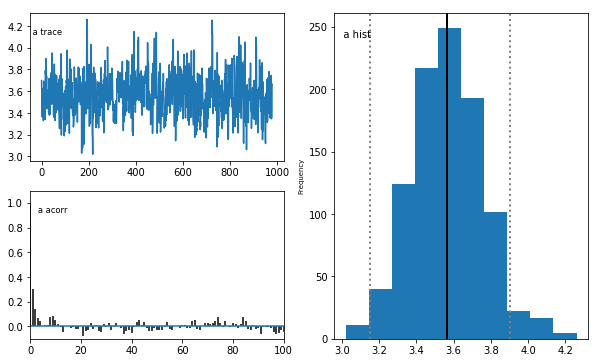

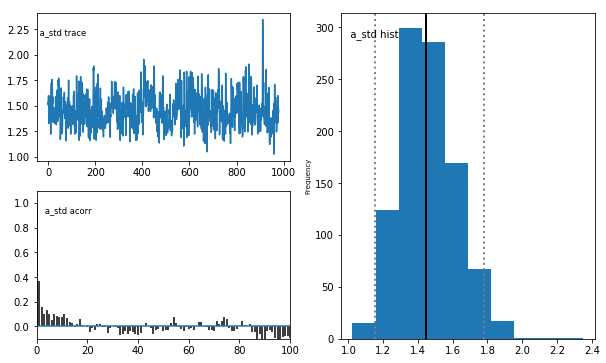

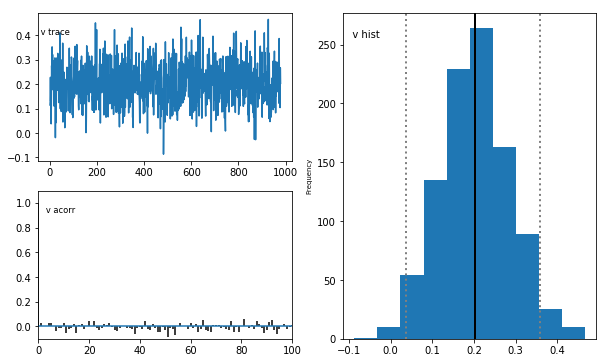

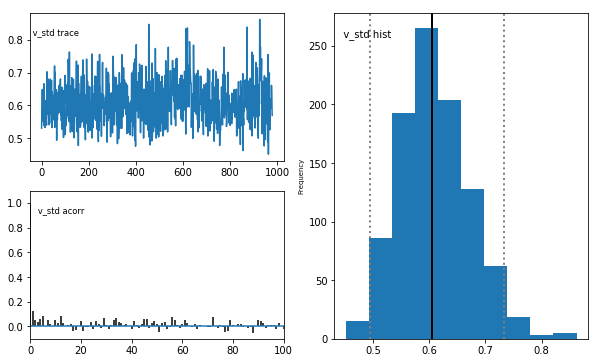

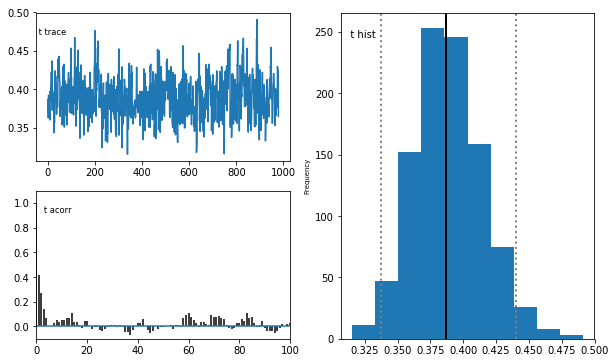

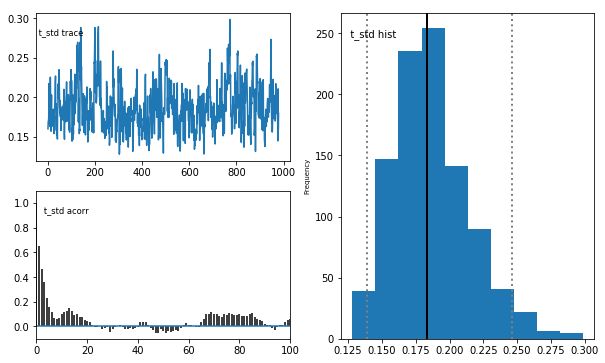

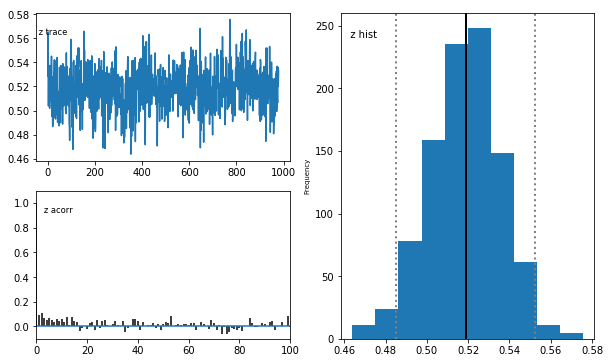

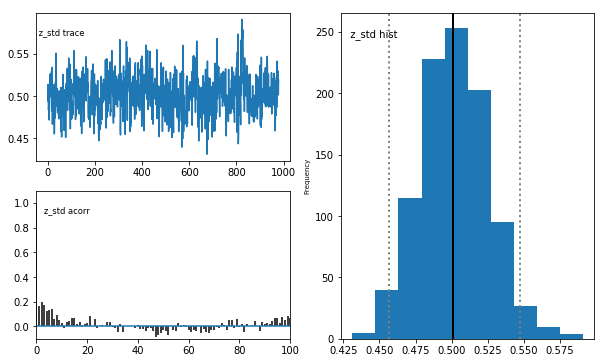

In [37]:
m_fix_3.plot_posteriors()

Plotting a
Plotting a_std
Plotting v
Plotting v_std
Plotting t
Plotting t_std
Plotting z
Plotting z_std


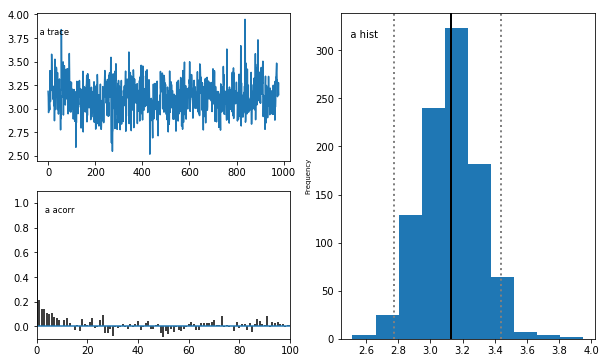

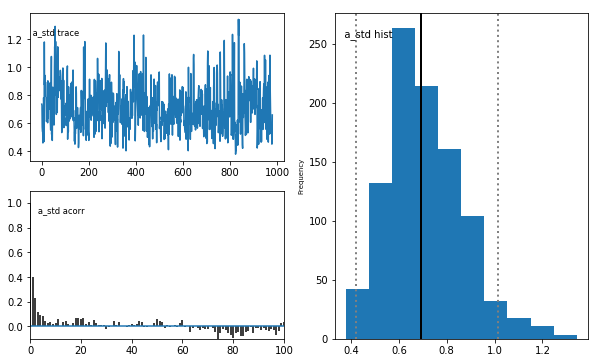

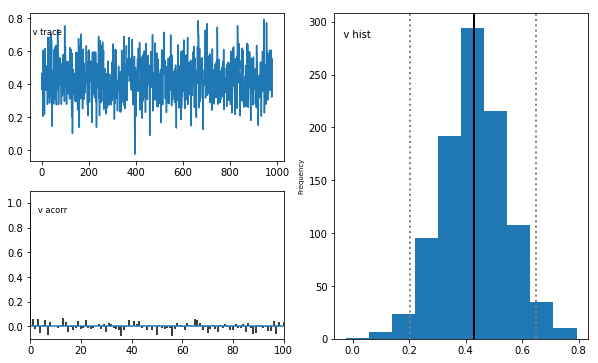

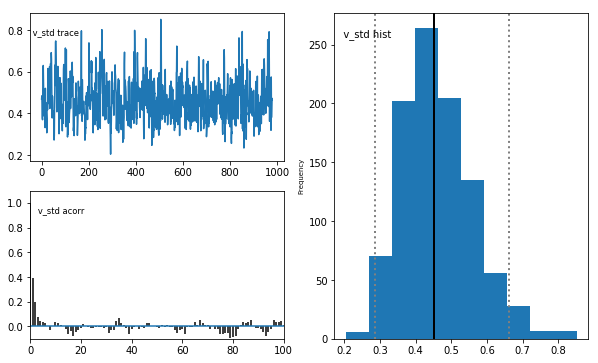

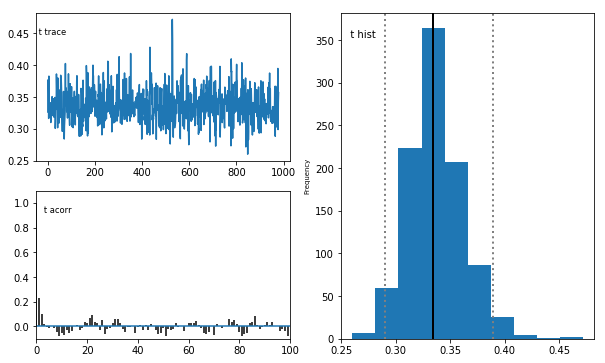

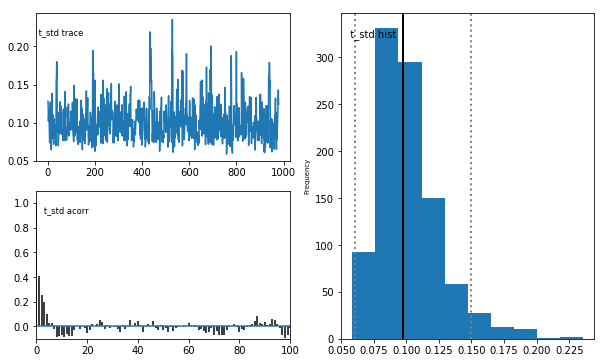

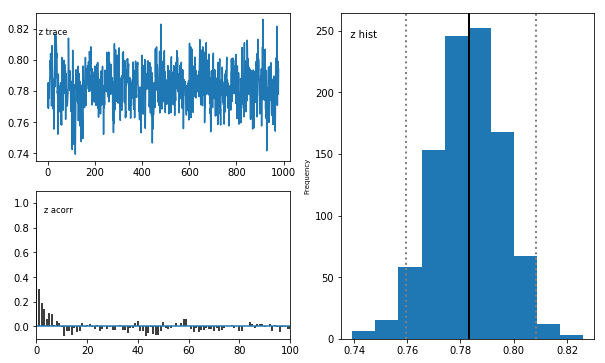

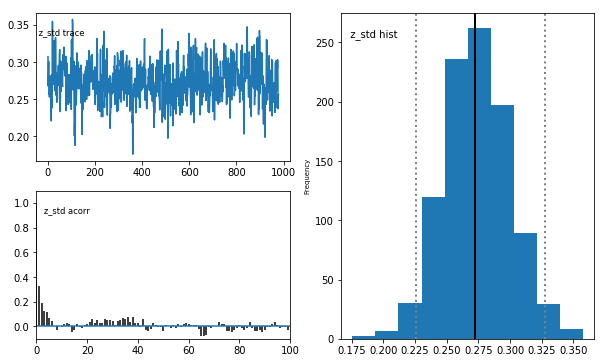

In [38]:
m_weak_3.plot_posteriors()

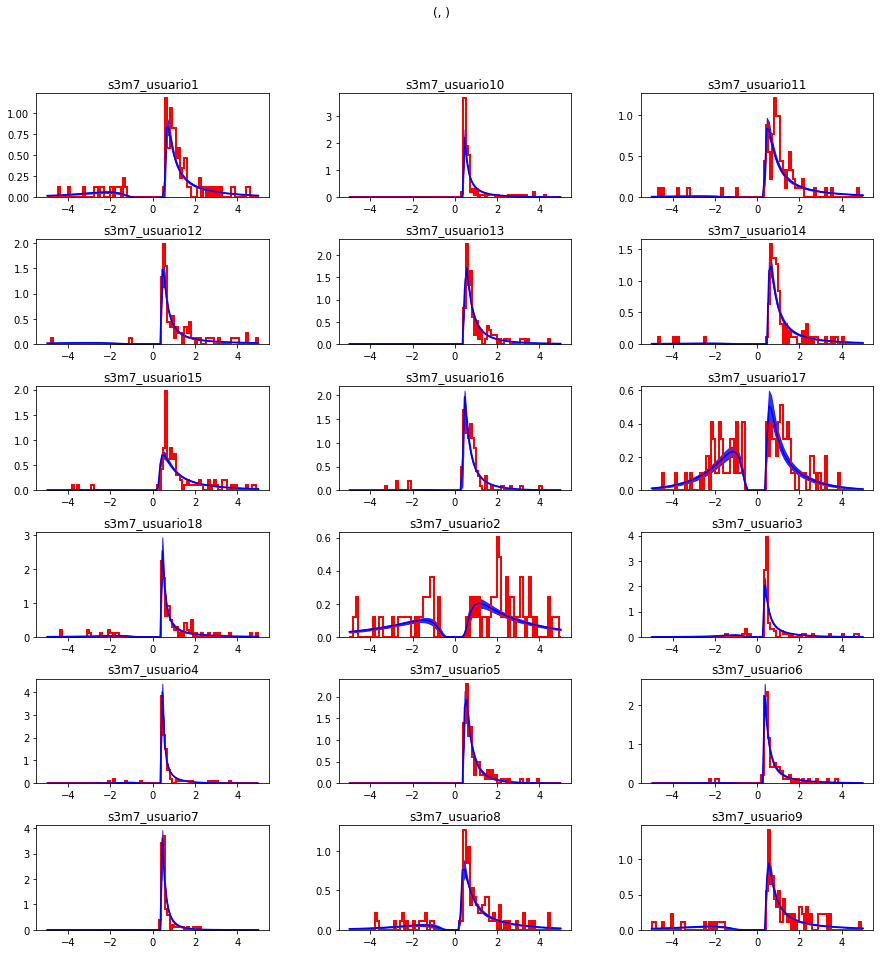

In [156]:
m_weak_3.plot_posterior_predictive(figsize=(15, 15))

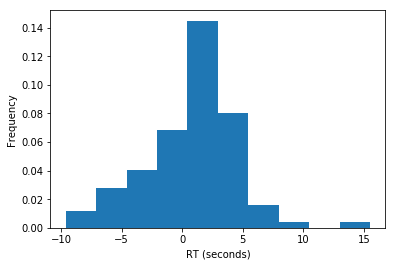

In [168]:
user = weak.loc[weak.player == "s3m7_usuario2"]

#plt.title("Weak PD")
plt.hist(user.rt, density = True)
plt.xlabel("RT (seconds)")
plt.ylabel("Frequency")
plt.show()

In [ ]:
#Test with round groups

#0-25
f_25 = fit_model(fixed_s[fixed_s["round"] <= 25], 1000, 400)
plot_params(f_25, "Fixed partners, first 25 rounds")

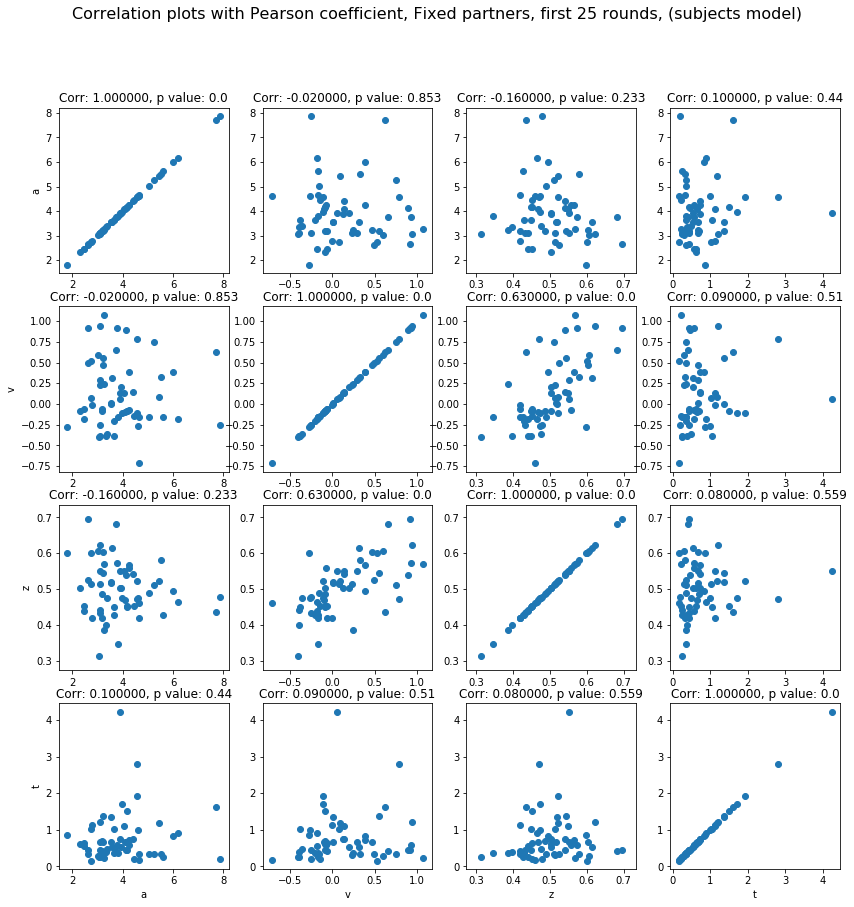

 [-----------------100%-----------------] 1000 of 1000 complete in 88.2 sec

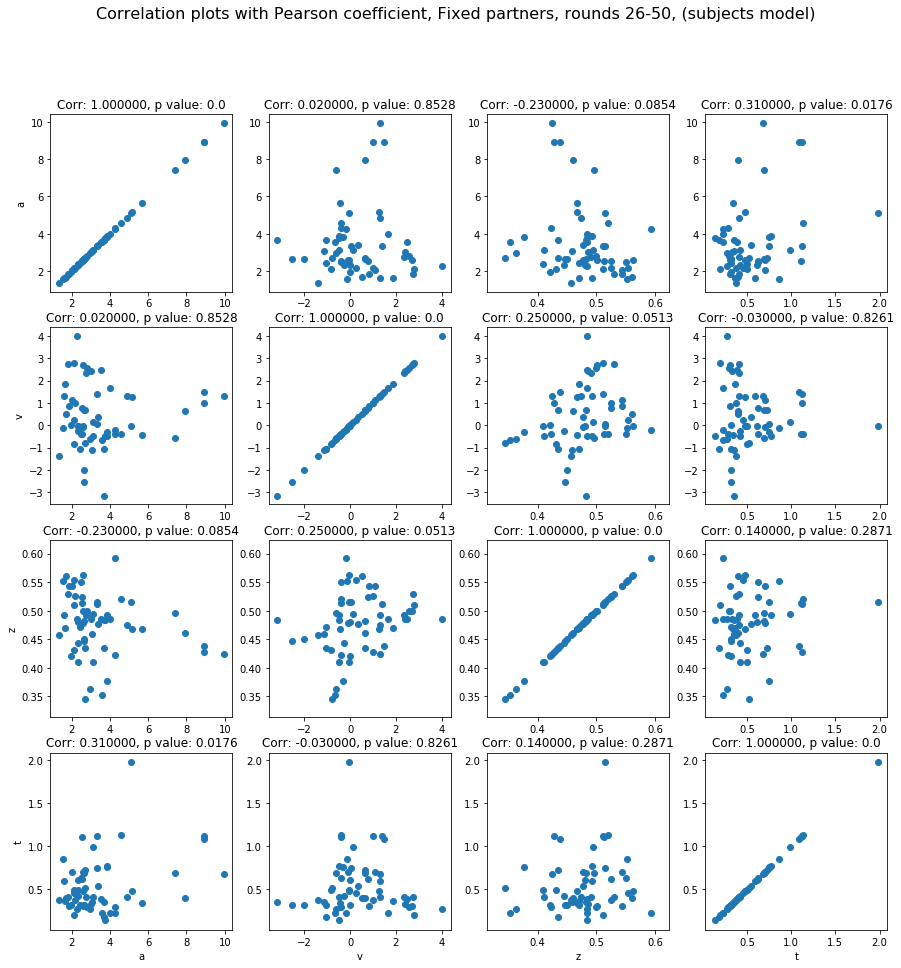

In [68]:
#26-50
rang = range(26,50)
f_26_50 = fit_model(fixed_s[fixed_s["round"].isin(rang)], 1000, 400)
plot_params(f_26_50, "Fixed partners, rounds 26-50")

 [-----------------100%-----------------] 1000 of 1000 complete in 76.4 sec

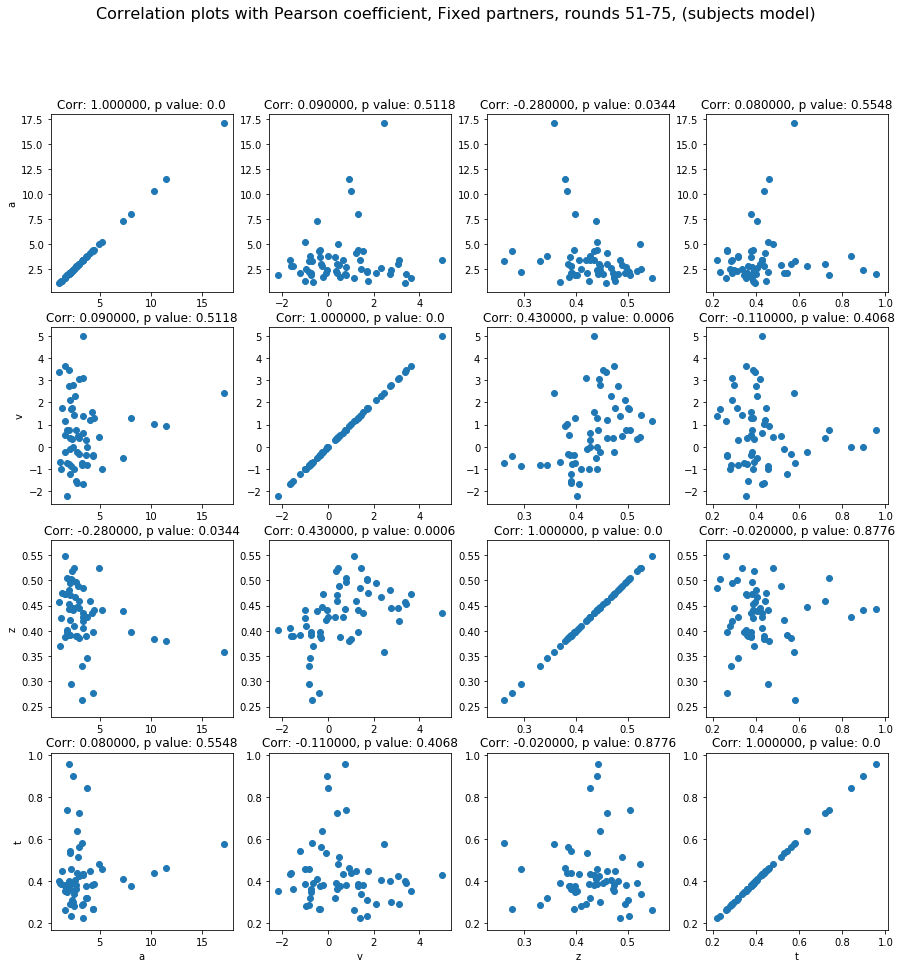

In [69]:
#51-75
rang = range(51,75)
f_51_75 = fit_model(fixed_s[fixed_s["round"].isin(rang)], 1000, 400)
plot_params(f_51_75, "Fixed partners, rounds 51-75")

 [-----------------100%-----------------] 1000 of 1000 complete in 73.0 sec

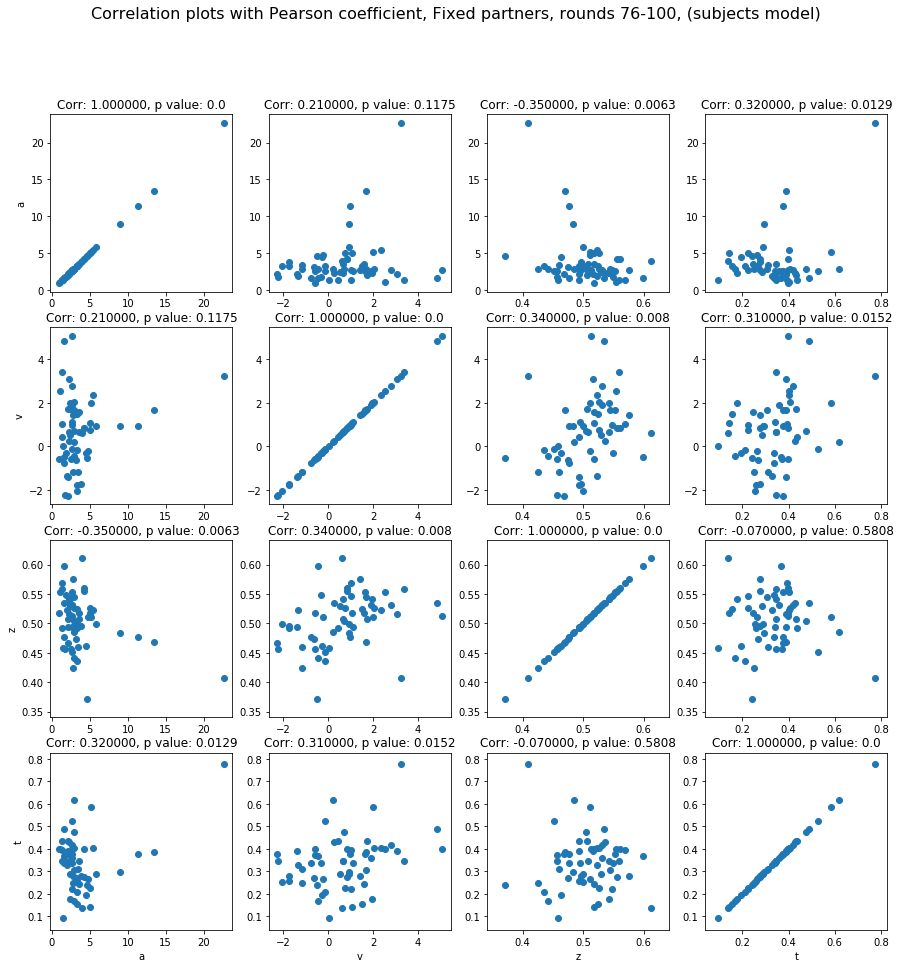

In [70]:
#76-100
rang = range(76,100)
f_76_100 = fit_model(fixed_s[fixed_s["round"].isin(rang)], 1000, 400)
plot_params(f_76_100, "Fixed partners, rounds 76-100")

 [-----------------100%-----------------] 1000 of 1000 complete in 200.0 sec

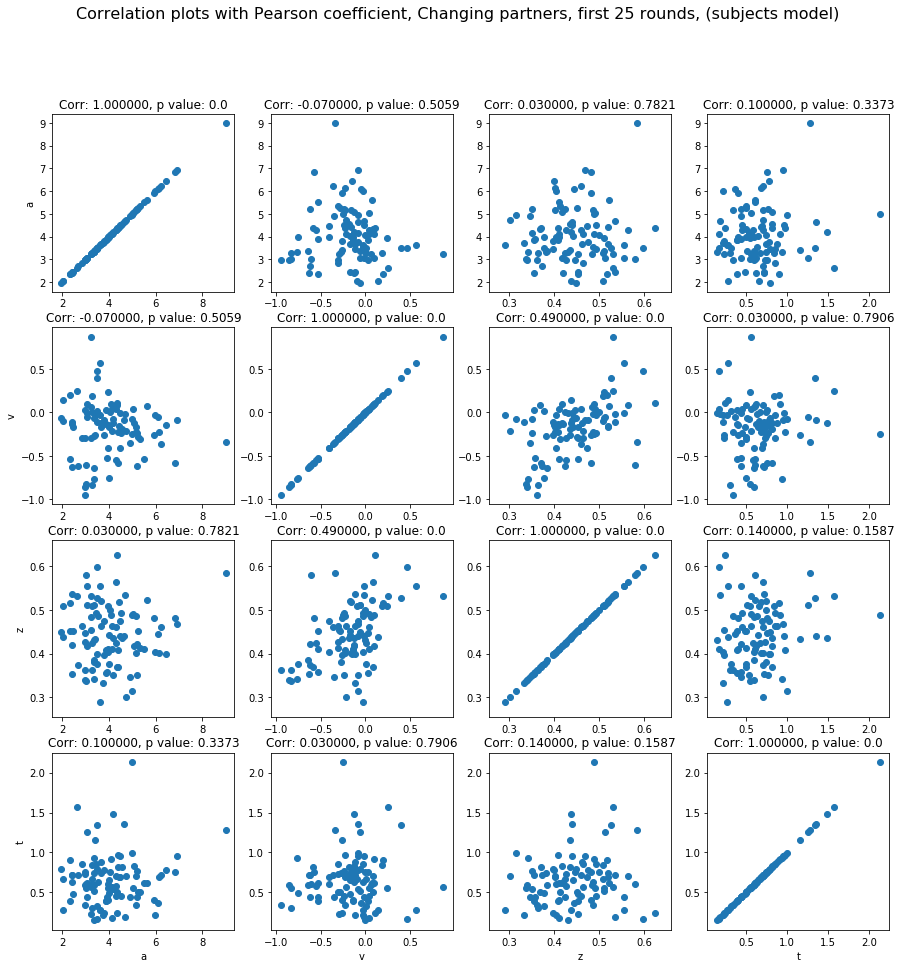

In [72]:
#Test with round groups CHANGING

#0-25
f_25 = fit_model(changing_s[changing_s["round"] <= 25], 1000, 400)
plot_params(f_25, "Changing partners, first 25 rounds")

 [-----------------100%-----------------] 1000 of 1000 complete in 139.0 sec

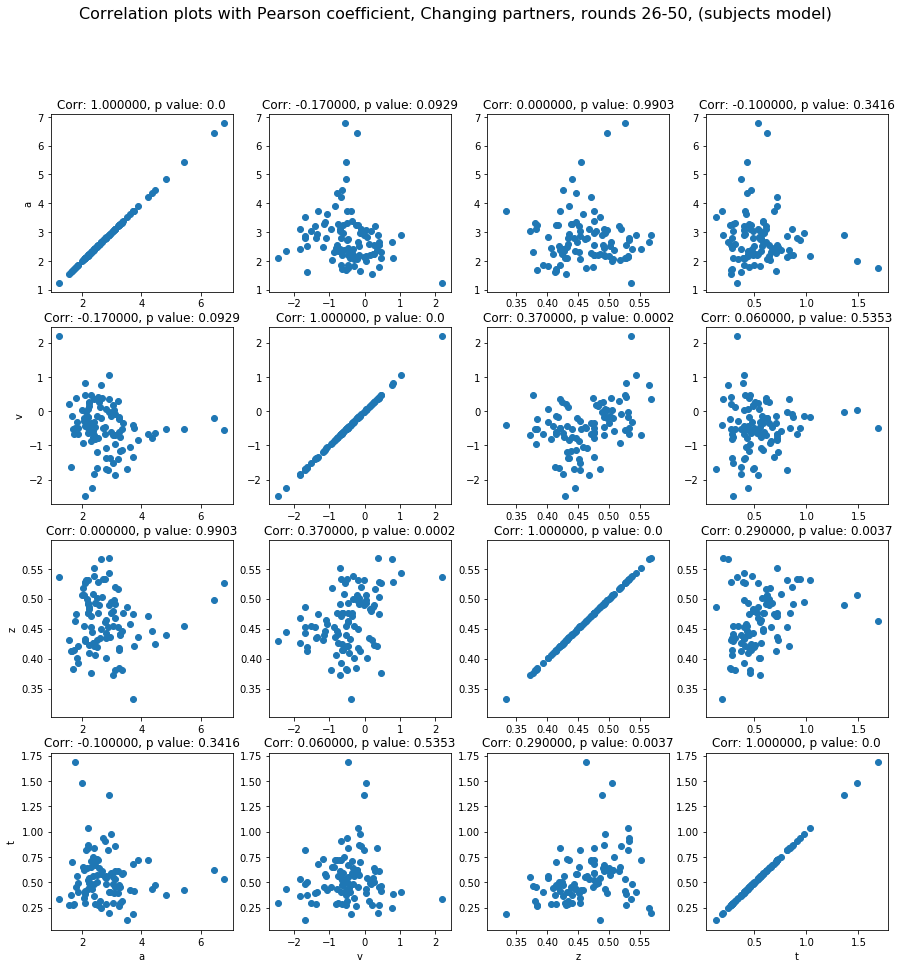

In [73]:
#26-50
rang = range(26,50)
f_26_50 = fit_model(changing_s[changing_s["round"].isin(rang)], 1000, 400)
plot_params(f_26_50, "Changing partners, rounds 26-50")

 [-----------------100%-----------------] 1000 of 1000 complete in 128.4 sec

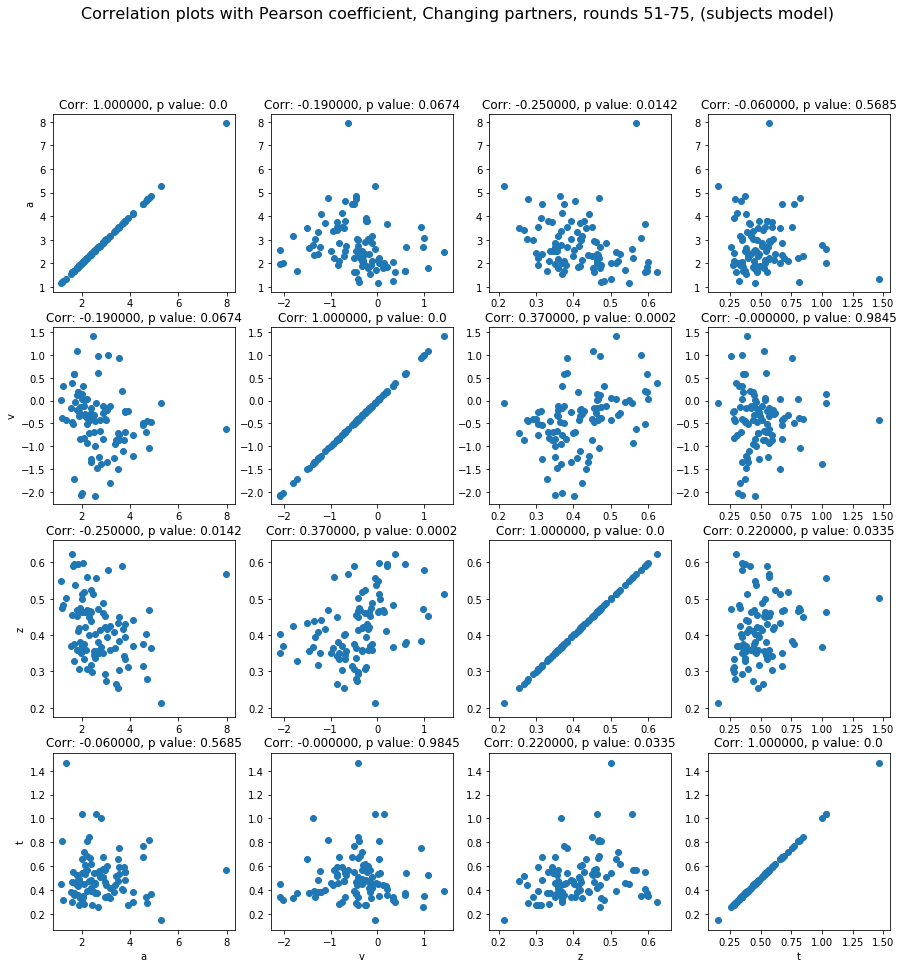

In [74]:
#51-75
rang = range(51,75)
f_51_75 = fit_model(changing_s[changing_s["round"].isin(rang)], 1000, 400)
plot_params(f_51_75, "Changing partners, rounds 51-75")

 [-----------------100%-----------------] 1001 of 1000 complete in 117.1 sec

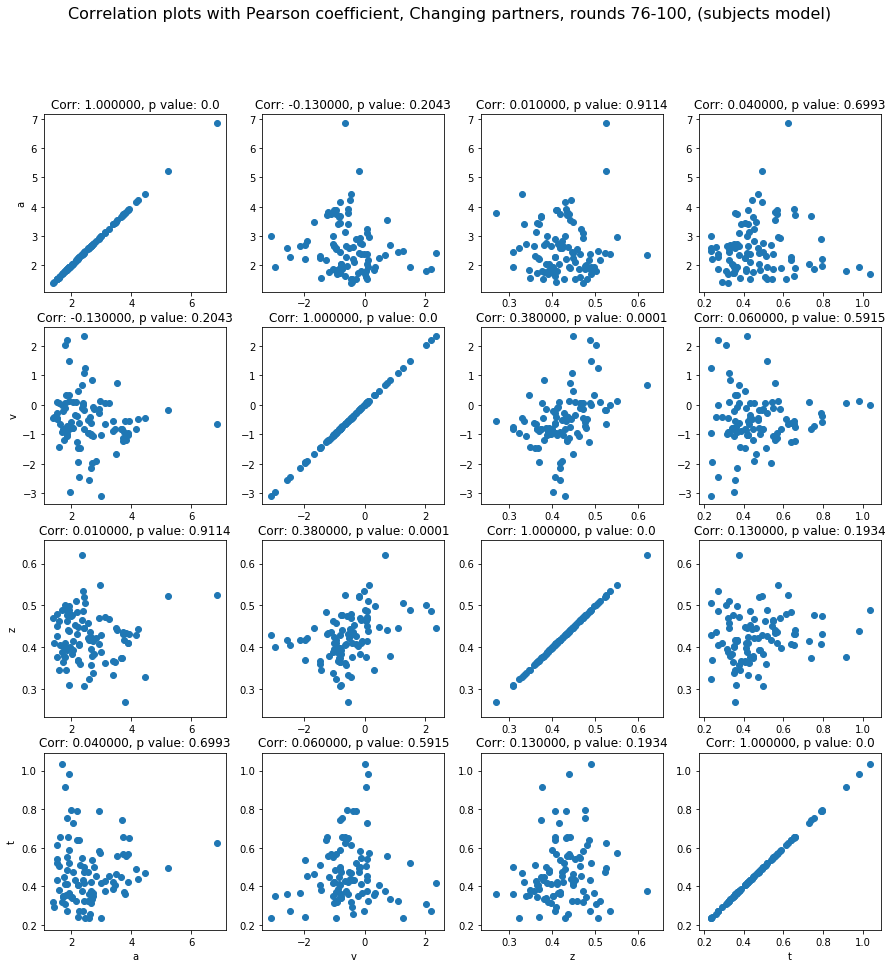

In [75]:
#76-100
rang = range(76,100)
f_76_100 = fit_model(changing_s[changing_s["round"].isin(rang)], 1000, 400)
plot_params(f_76_100, "Changing partners, rounds 76-100")

 [-----------------100%-----------------] 1000 of 1000 complete in 34.1 sec

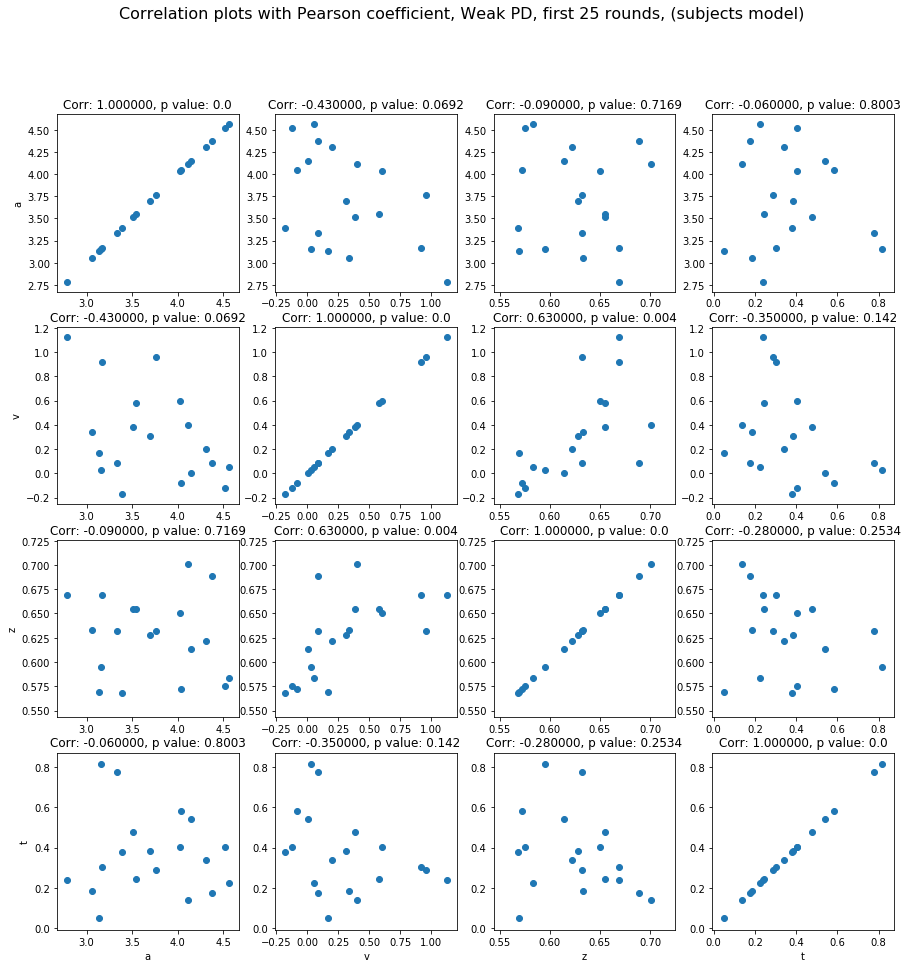

In [77]:
#Test with round groups WEAK

#0-25
f_25 = fit_model(weak_s[weak_s["round"] <= 25], 1000, 400)
plot_params(f_25, "Weak PD, first 25 rounds")

 [-----------------100%-----------------] 1000 of 1000 complete in 23.2 sec

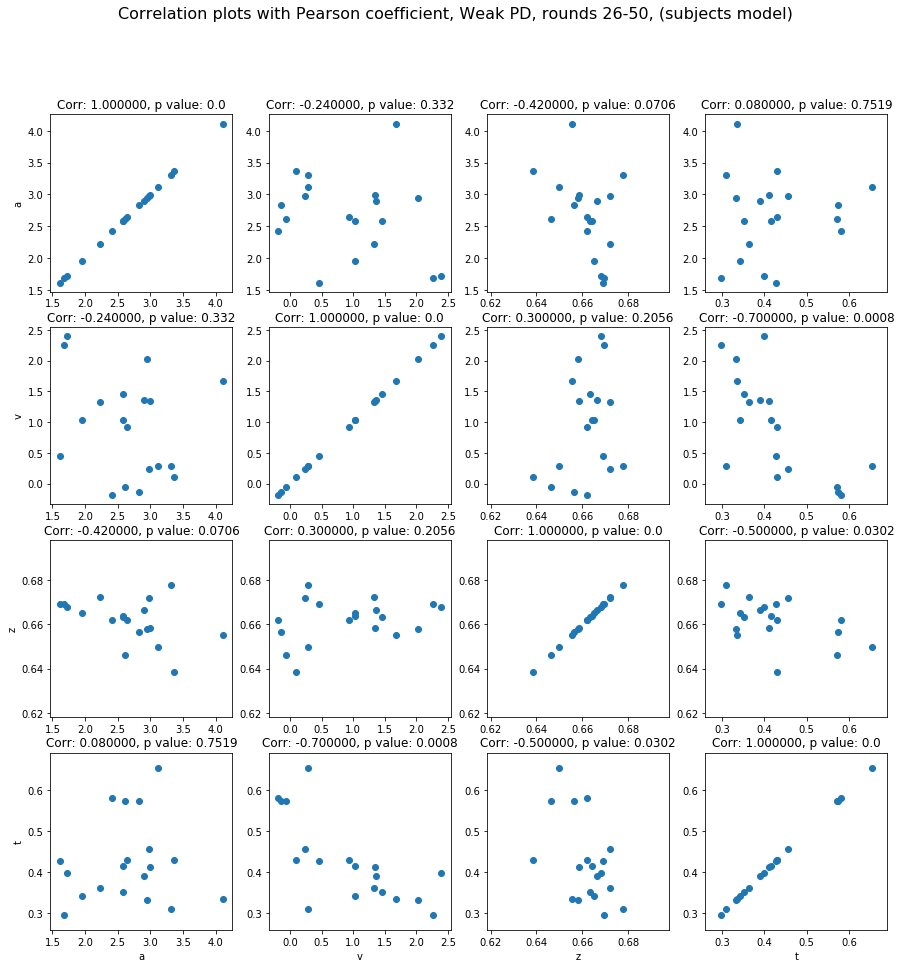

In [80]:
#26-50
rang = range(26,50)
f_26_50 = fit_model(weak_s[weak_s["round"].isin(rang)], 1000, 400)
plot_params(f_26_50, "Weak PD, rounds 26-50")

 [-----------------100%-----------------] 1000 of 1000 complete in 20.7 sec

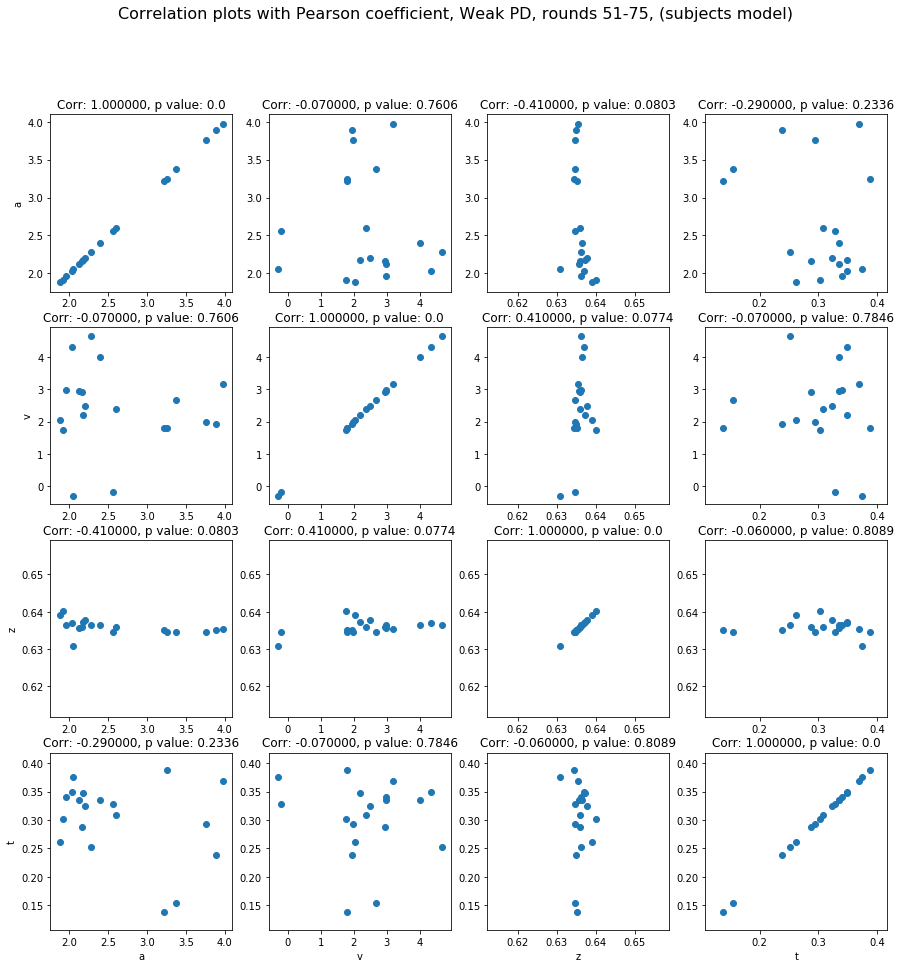

In [78]:
#51-75
rang = range(51,75)
f_51_75 = fit_model(weak_s[weak_s["round"].isin(rang)], 1000, 400)
plot_params(f_51_75, "Weak PD, rounds 51-75")

 [-----------------100%-----------------] 1000 of 1000 complete in 20.0 sec

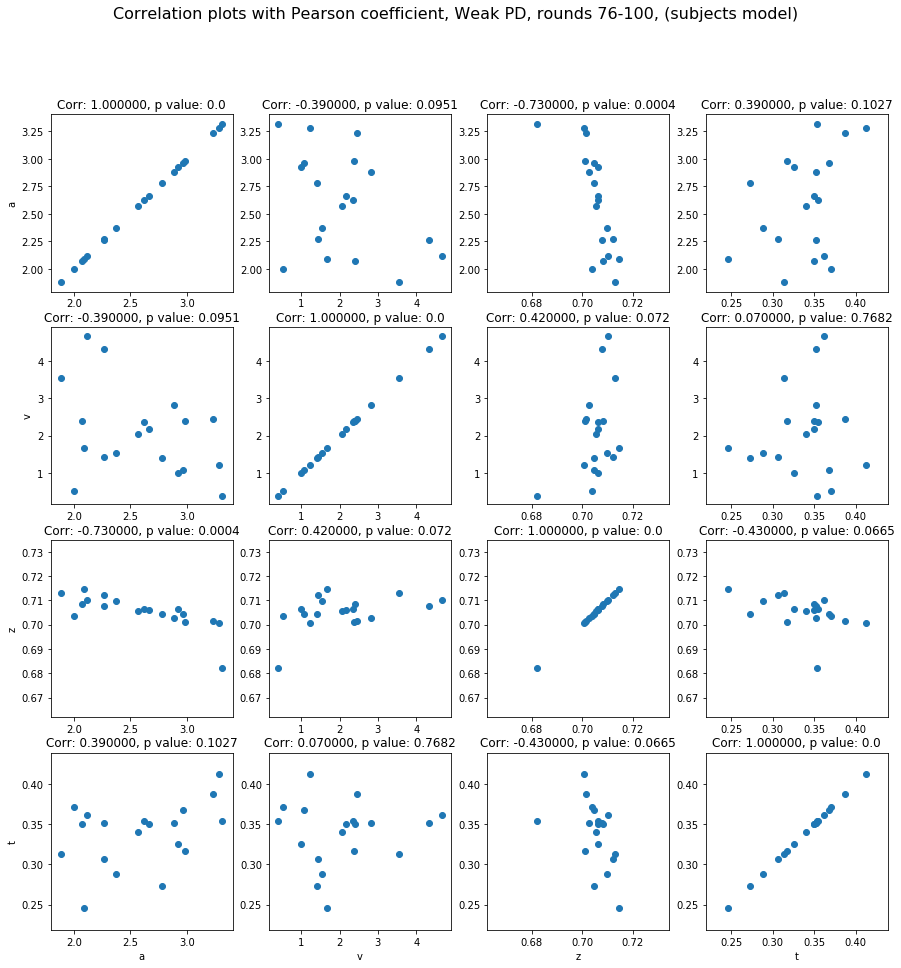

In [81]:
#76-100
rang = range(76,100)
f_76_100 = fit_model(weak_s[weak_s["round"].isin(rang)], 1000, 400)
plot_params(f_76_100, "Weak PD, rounds 76-100")

## Tests with rounds

 [-----------------100%-----------------] 1001 of 1000 complete in 141.4 secPlotting a
Plotting a_std
Plotting v
Plotting v_std
Plotting t
Plotting t_std
Plotting z
Plotting z_std


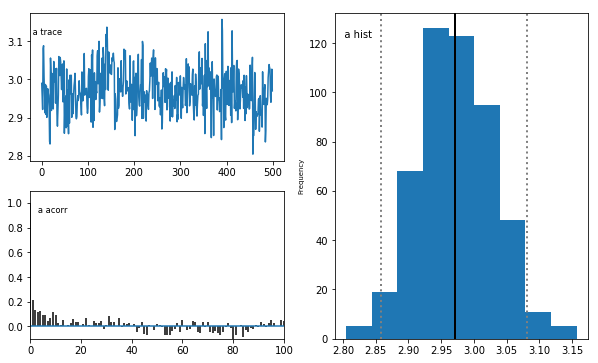

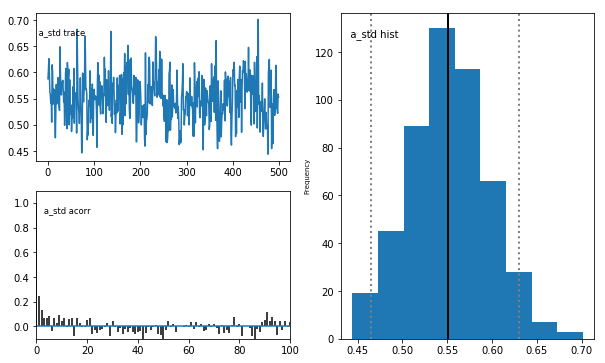

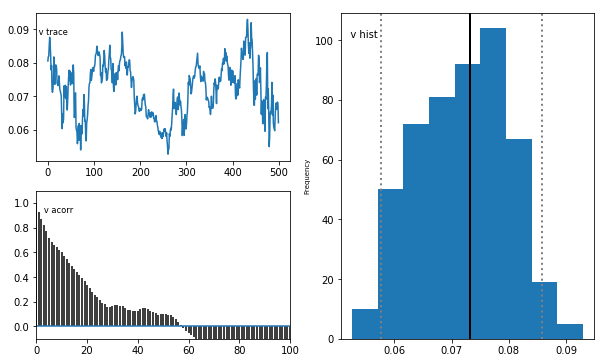

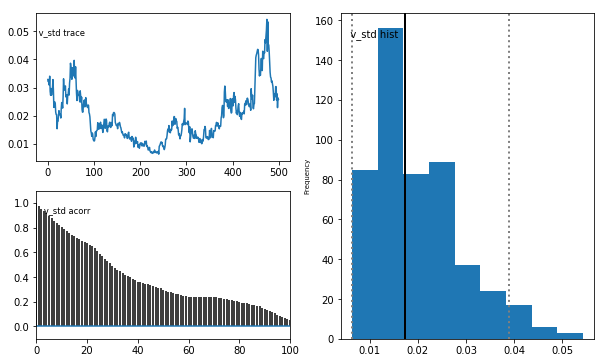

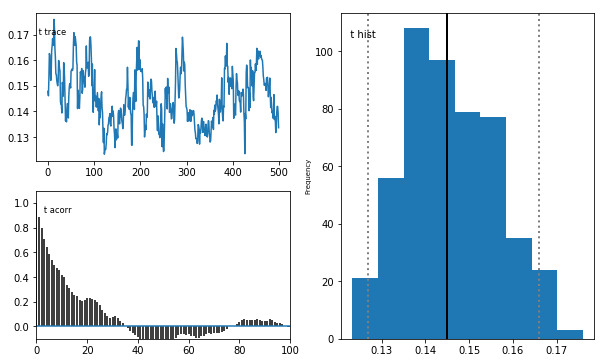

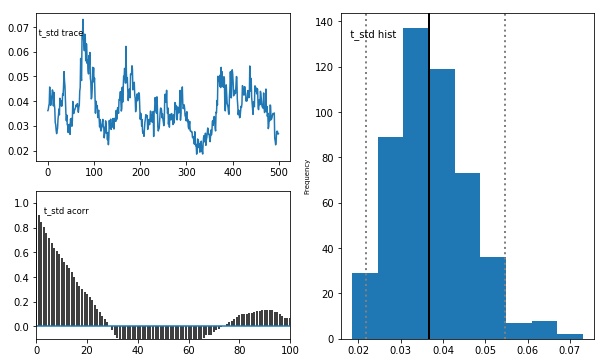

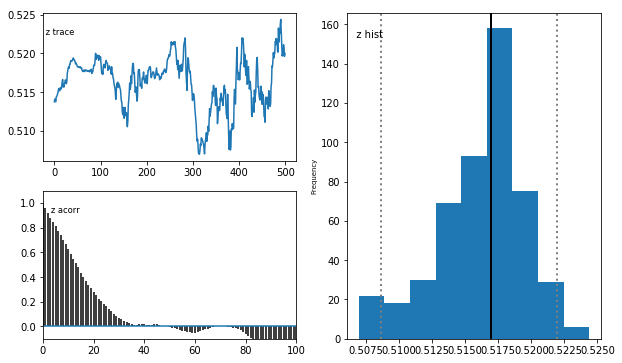

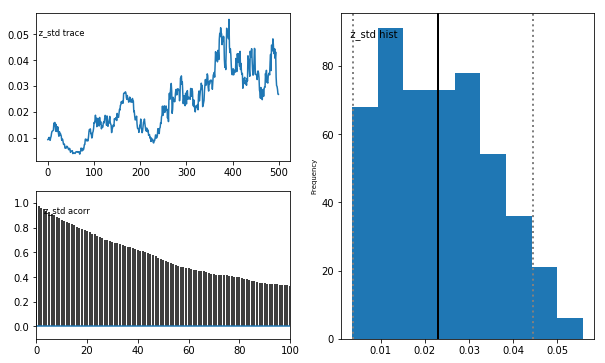

In [107]:
fixed_r=fixed.copy()
fixed_r.rename(columns={"round":"subj_idx"},inplace=True)
stats_f = fit_model(fixed_r, 1000, 500)


 [-----------------100%-----------------] 1000 of 1000 complete in 145.6 secPlotting a
Plotting a_std
Plotting v
Plotting v_std
Plotting t
Plotting t_std
Plotting z
Plotting z_std


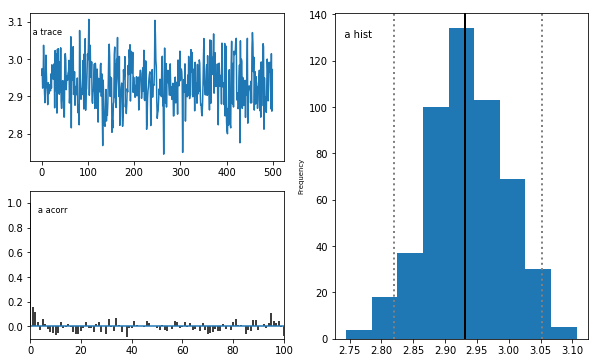

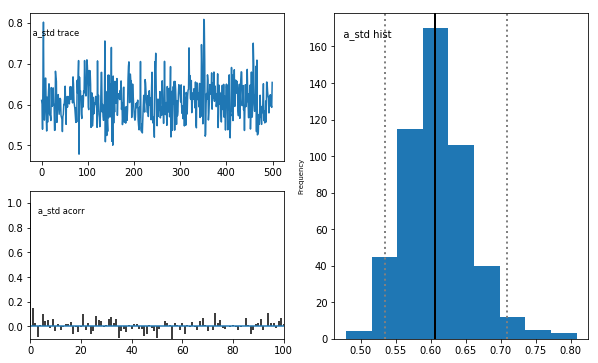

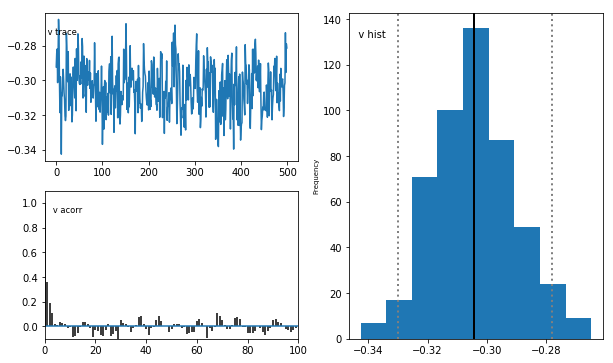

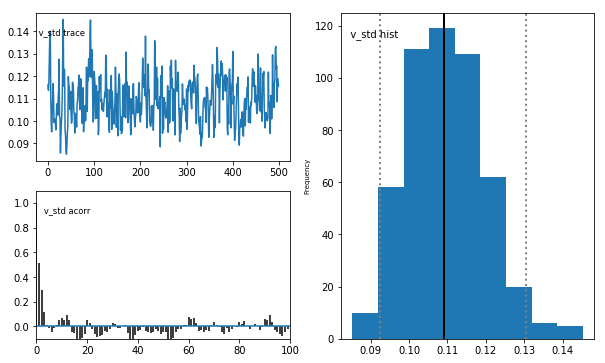

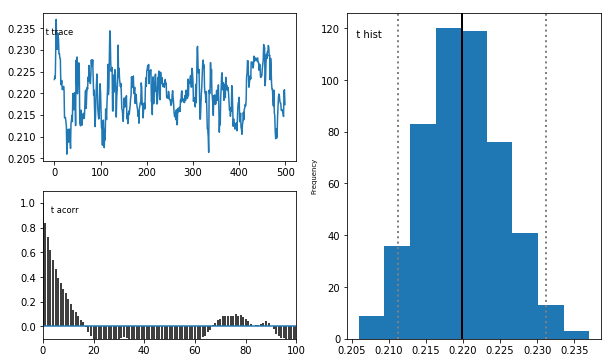

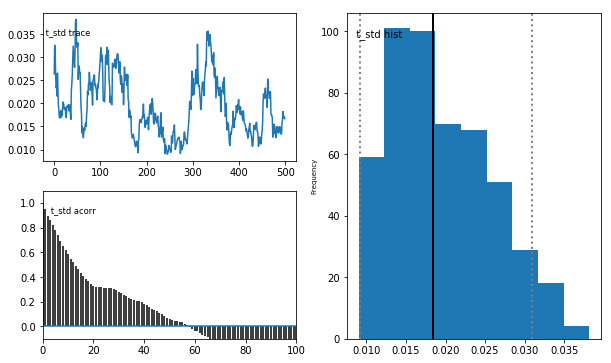

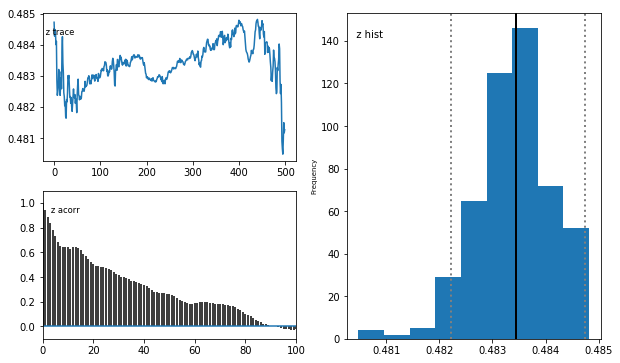

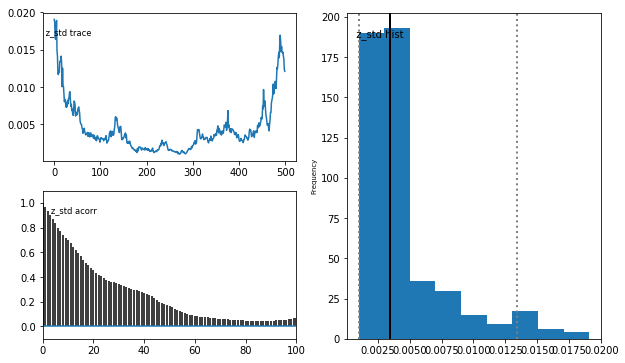

In [108]:
chang_r=changing.copy()
chang_r.rename(columns={"round":"subj_idx"},inplace=True)
stats_c = fit_model(chang_r, 1000, 500)

 [-----------------100%-----------------] 1000 of 1000 complete in 118.0 secPlotting a
Plotting a_std
Plotting v
Plotting v_std
Plotting t
Plotting t_std
Plotting z
Plotting z_std


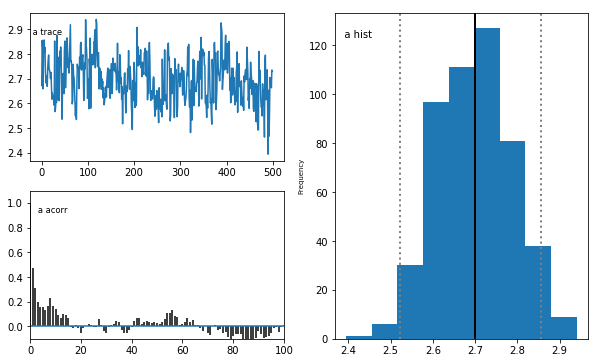

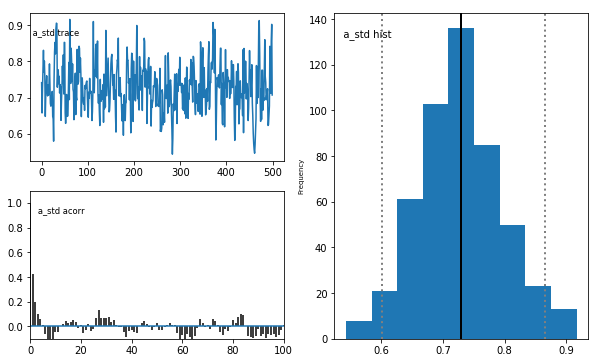

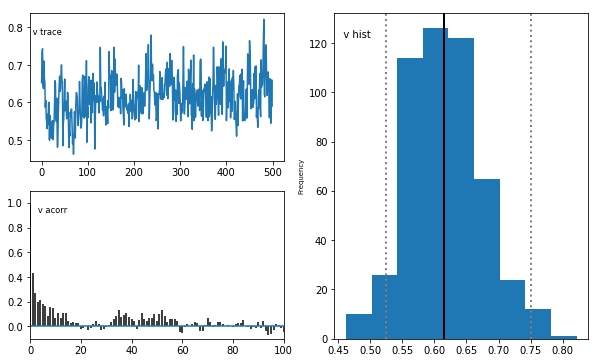

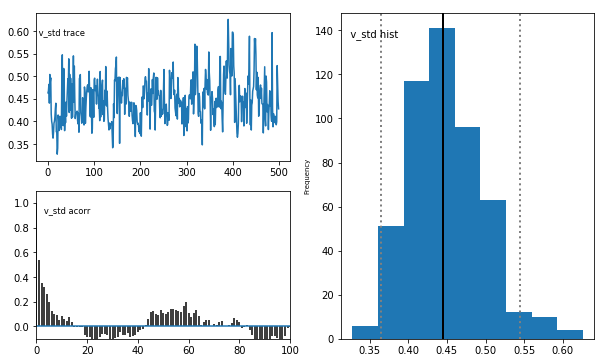

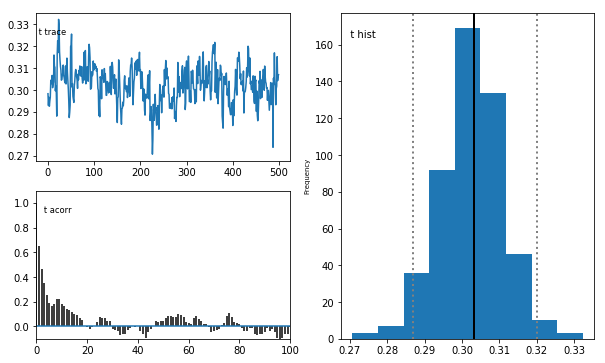

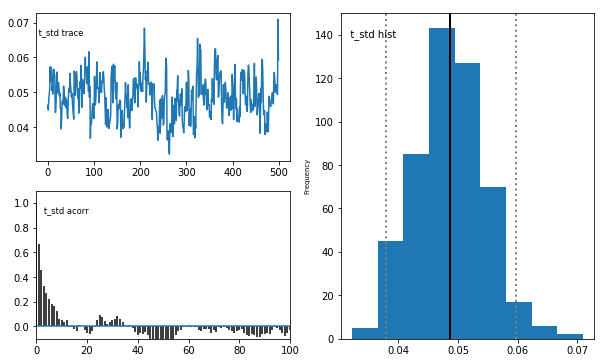

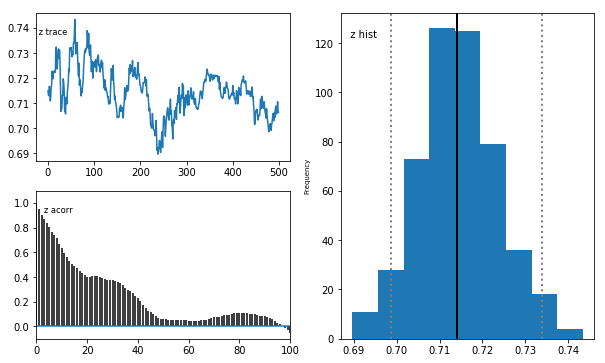

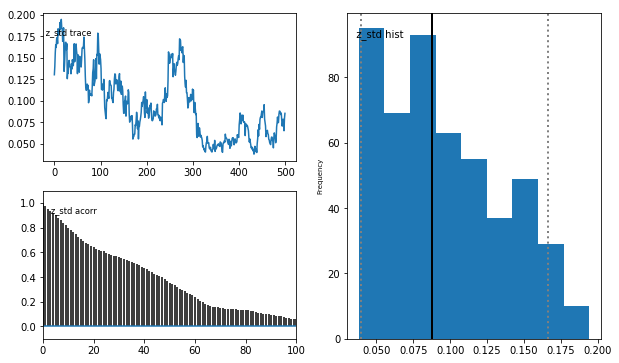

In [109]:
weak_r=weak.copy()
weak_r.rename(columns={"round":"subj_idx"},inplace=True)
stats_w = fit_model(weak_r, 1000, 500)

In [112]:
stats_w = stats_w.dropna()
stats_f = stats_f.dropna()
stats_c = stats_c.dropna()

Rounds: 1
 [-----------------100%-----------------] 10 of 10 complete in 0.7 secPlotting a
Plotting a_std
Plotting v
Plotting v_std
Plotting t
Plotting t_std
Plotting z
Plotting z_std
 [------------------110%-------------------] 11 of 10 complete in 1.2 secPlotting a
Plotting a_std
Plotting v
Plotting v_std
Plotting t
Plotting t_std
Plotting z
Plotting z_std
 [-----------------100%-----------------] 10 of 10 complete in 0.2 secPlotting a
Plotting a_std
Plotting v
Plotting v_std
Plotting t
Plotting t_std
Plotting z
Plotting z_std
Rounds: 2
 [-----------------100%-----------------] 10 of 10 complete in 0.9 secPlotting a
Plotting a_std
Plotting v
Plotting v_std
Plotting t
Plotting t_std
Plotting z
Plotting z_std
 [-----------------100%-----------------] 10 of 10 complete in 1.3 secPlotting a
Plotting a_std
Plotting v
Plotting v_std
Plotting t
Plotting t_std
Plotting z
Plotting z_std
 [-----------------100%-----------------] 10 of 10 complete in 0.2 secPlotting a
Plotting a_std
Plotting v


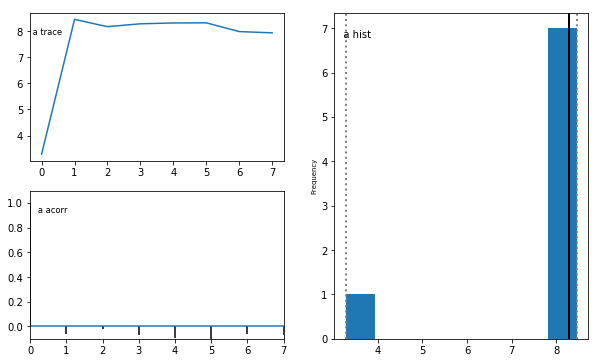

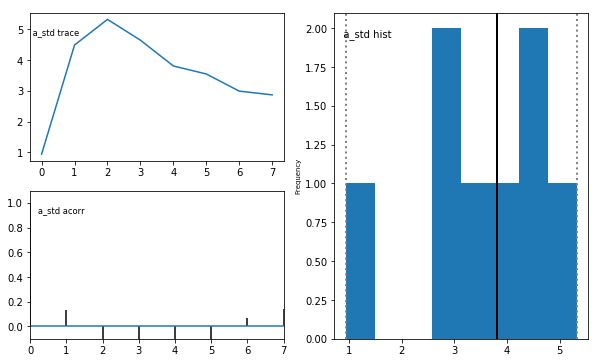

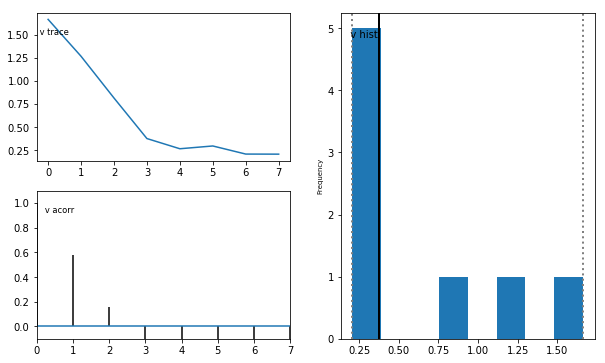

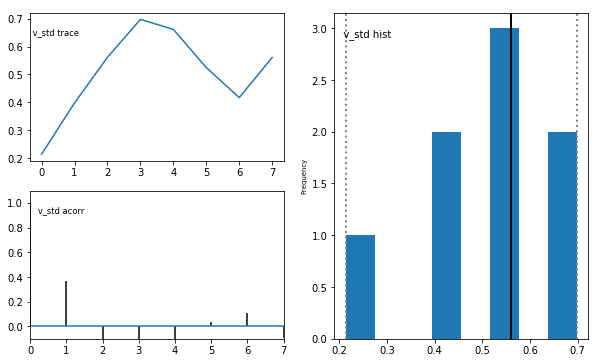

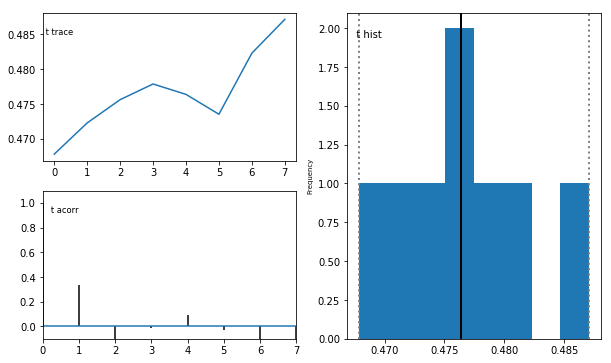

...

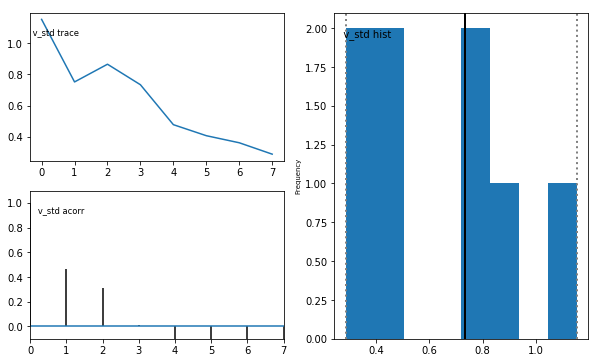

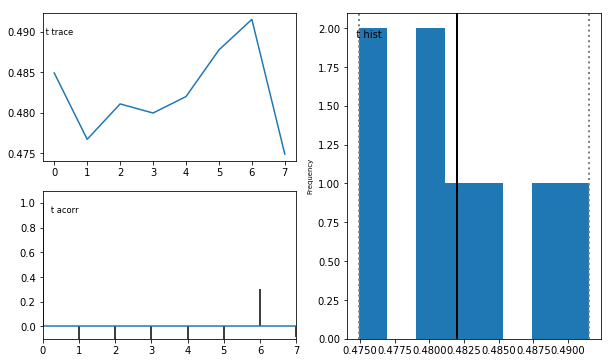

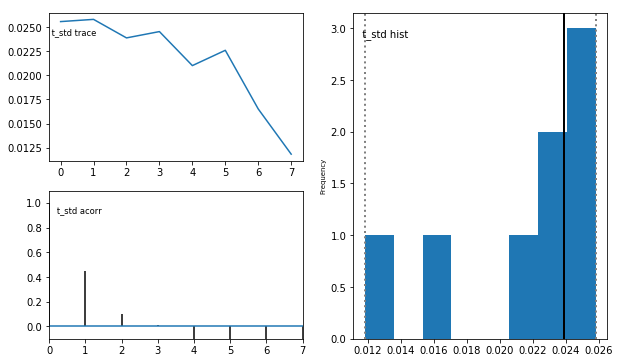

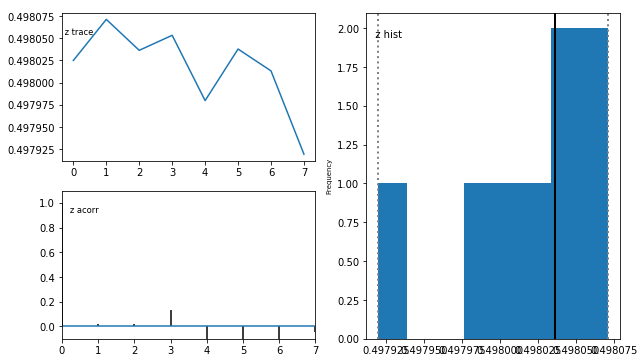

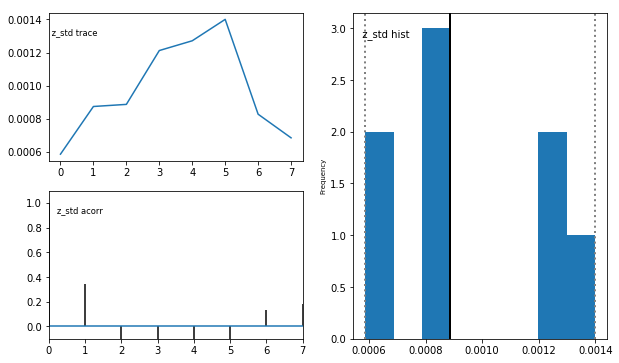

In [187]:
rounds = range(1,4)
#f_rounds = pd.DataFrame()
#c_rounds = pd.DataFrame()
#w_rounds = pd.DataFrame()

for r in rounds:
    print("Rounds: %d" % r)
    df_f = fit_model(fixed_s.loc[fixed_s["round"] == r], 10, 2)
    df_c = fit_model(changing_s.loc[changing_s["round"] == r], 10, 2)
    df_w = fit_model(weak_s.loc[weak_s["round"] == r], 10, 2)
    
    df_f["round"] = r
    df_c["round"] = r
    df_w["round"] = r
    if r == 1:
        f_rounds = df_f
        c_rounds = df_c
        w_rounds = df_w
    else:
        f_rounds.append(df_f,  ignore_index = True)
        c_rounds.append(df_c, ignore_index = True)
        w_rounds.append(df_w, ignore_index = True)

In [188]:
c_rounds

,mean,std,2.5q,25q,50q,75q,97.5q,mc err,param,subject,round
0,4.40254,1.09375,2.97927,3.87994,4.24479,5.80747,6.21009,0.386699,a,None,1
1,1.11558,0.424167,0.494775,0.810877,1.27974,1.62542,1.69387,0.149966,a_std,None,1
2,4.69213,1.44813,3.44989,3.56418,3.75792,6.48323,6.78527,0.511993,a,s11n9_usuario1,1
3,4.44639,1.57143,2.77426,3.36235,4.15021,5.28921,8.1172,0.555585,a,s11n9_usuario10,1
4,4.35533,1.06622,2.73537,3.70062,4.3216,5.53919,6.17745,0.376965,a,s11n9_usuario2,1
5,3.79368,0.886406,2.97165,3.29999,3.59347,4.7386,5.67706,0.313392,a,s11n9_usuario3,1
6,4.73663,1.33657,2.36383,3.76722,4.8809,6.15551,6.5705,0.472548,a,s11n9_usuario4,1
7,4.73195,2.03497,3.0618,3.30481,3.63444,6.09927,9.20903,0.719469,a,s11n9_usuario5,1
8,4.07041,1.08831,2.80388,3.07875,3.76992,5.36679,5.86048,0.384775,a,s11n9_usuario6,1
9,4.19789,0.971987,3.25401,3.4413,4.16001,4.76686,6.40123,0.343649,a,s11n9_usuario7,1


In [124]:
fix_m_r.gen_stats()


,mean,std,2.5q,25q,50q,75q,97.5q,mc err
a,3.40874,0.202467,3.03331,3.27133,3.39812,3.54164,3.84977,0.00788323
a_std,1.54874,0.180589,1.24291,1.4202,1.53301,1.6619,1.94438,0.00872819
a_subj.s10n5_usuario1,3.73989,0.152532,3.44236,3.63292,3.74185,3.84579,4.04025,0.00513722
a_subj.s10n5_usuario2,3.09999,0.152152,2.8306,2.99159,3.08857,3.20061,3.42328,0.00594752
a_subj.s10n5_usuario3,2.56906,0.199051,2.23225,2.42479,2.5561,2.68687,3.00593,0.0117842
a_subj.s10n5_usuario4,3.5286,0.239224,3.09243,3.36283,3.50946,3.67953,4.0161,0.0110643
a_subj.s10n5_usuario5,3.59331,0.119171,3.36352,3.50891,3.59306,3.67512,3.83222,0.00277017
a_subj.s10n5_usuario6,2.86163,0.141049,2.60103,2.76247,2.85897,2.95238,3.14982,0.00570001
a_subj.s10n5_usuario7,1.94003,0.0986217,1.75467,1.87153,1.93615,2.00358,2.15087,0.0036973
a_subj.s10n5_usuario8,1.77558,0.087287,1.62122,1.71478,1.77284,1.83231,1.9509,0.00336687


Text(0,0.5,'a')

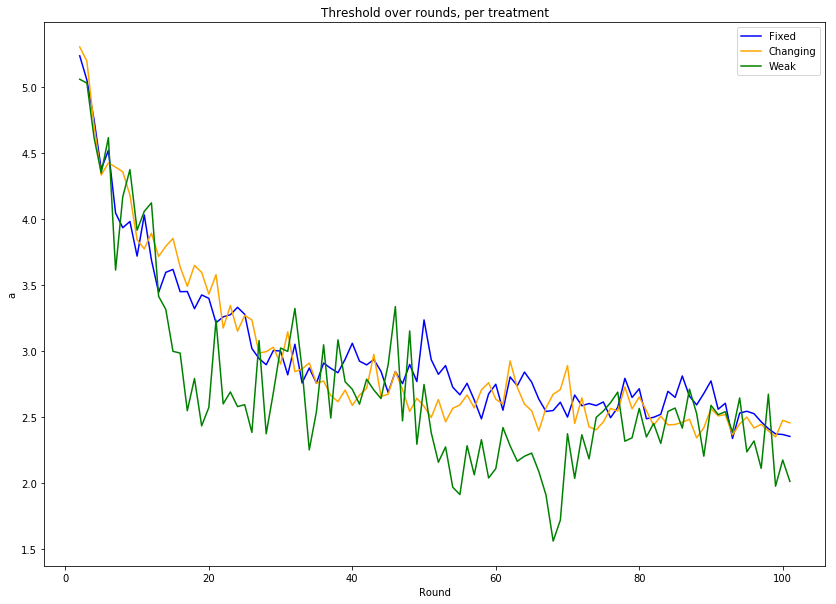

In [154]:
plt.figure(figsize = (14,10))
plt.plot(stats_f.loc[stats_f.param == "a", "mean"], label = "Fixed", color = "blue")
plt.plot(stats_c.loc[stats_c.param == "a", "mean"], label = "Changing", color = "orange")
plt.plot(stats_w.loc[stats_w.param == "a", "mean"], label = "Weak", color = "green")
plt.legend(loc = "best")
plt.title("Threshold over rounds, per treatment")
plt.xlabel("Round")
plt.ylabel("a")

Text(0,0.5,'z')

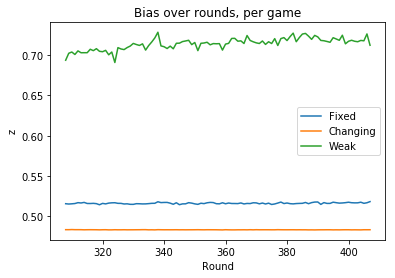

In [115]:
plt.plot(stats_f.loc[stats_f.param == "z", "mean"], label = "Fixed")
plt.plot(stats_c.loc[stats_c.param == "z", "mean"], label = "Changing")
plt.plot(stats_w.loc[stats_w.param == "z", "mean"], label = "Weak")
plt.legend(loc = "best")
plt.title("Bias over rounds, per game")
plt.xlabel("Round")
plt.ylabel("z")

Text(0,0.5,'v')

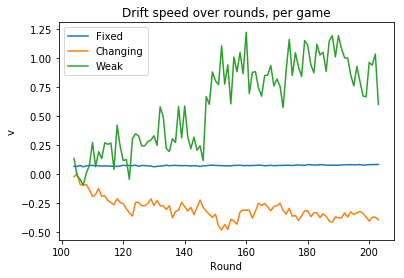

In [116]:
plt.plot(stats_f.loc[stats_f.param == "v", "mean"], label = "Fixed")
plt.plot(stats_c.loc[stats_c.param == "v", "mean"], label = "Changing")
plt.plot(stats_w.loc[stats_w.param == "v", "mean"], label = "Weak")
plt.legend(loc = "best")
plt.title("Drift speed over rounds, per game")
plt.xlabel("Round")
plt.ylabel("v")

Text(0,0.5,'t0')

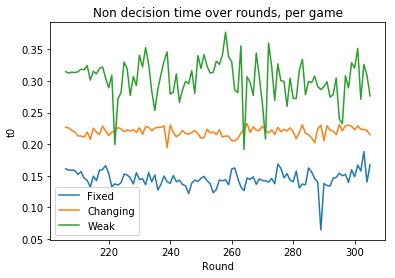

In [117]:
plt.plot(stats_f.loc[stats_f.param == "t", "mean"], label = "Fixed")
plt.plot(stats_c.loc[stats_c.param == "t", "mean"], label = "Changing")
plt.plot(stats_w.loc[stats_w.param == "t", "mean"], label = "Weak")
plt.legend(loc = "best")
plt.title("Non decision time over rounds, per game")
plt.xlabel("Round")
plt.ylabel("t0")

Plotting a(1)
Plotting a(2)
Plotting a(3)
Plotting a(4)
Plotting a(5)
Plotting a(6)
Plotting a(7)
Plotting a(8)
Plotting a(9)
Plotting a(10)
Plotting a(11)
Plotting a(12)
Plotting a(13)
Plotting a(14)
Plotting a(15)
Plotting a(16)
Plotting a(17)
Plotting a(18)
Plotting a(19)
Plotting a(20)
Plotting a(21)
Plotting a(22)
Plotting a(23)
Plotting a(24)
Plotting a(25)
Plotting a(26)
Plotting a(27)
Plotting a(28)
Plotting a(29)
Plotting a(30)
Plotting a(31)
Plotting a(32)
Plotting a(33)
Plotting a(34)
Plotting a(35)
Plotting a(36)
Plotting a(37)
Plotting a(38)
Plotting a(39)
Plotting a(40)
Plotting a(41)
Plotting a(42)
Plotting a(43)
Plotting a(44)
Plotting a(45)
Plotting a(46)
Plotting a(47)
Plotting a(48)
Plotting a(49)
Plotting a(50)
Plotting a(51)
Plotting a(52)
Plotting a(53)
Plotting a(54)
Plotting a(55)
Plotting a(56)
Plotting a(57)
Plotting a(58)
Plotting a(59)
Plotting a(60)
Plotting a(61)
Plotting a(62)
Plotting a(63)
Plotting a(64)
Plotting a(65)
Plotting a(66)
Plotting a(67)
Plot

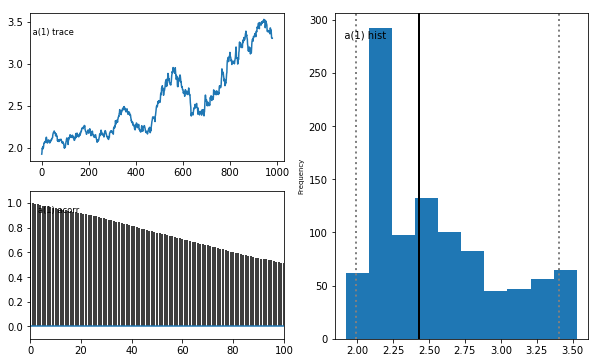

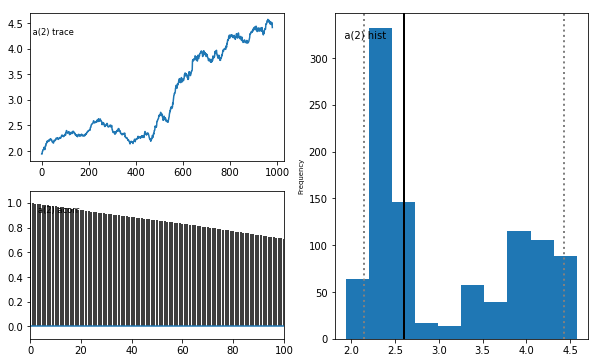

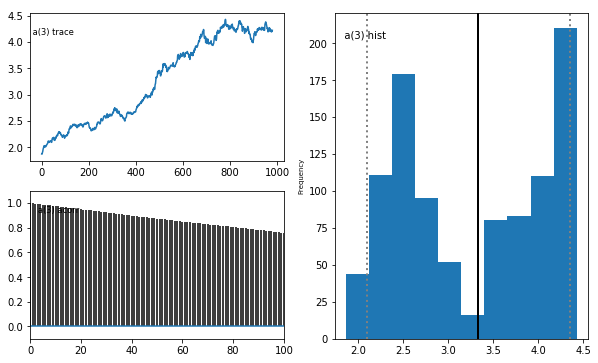

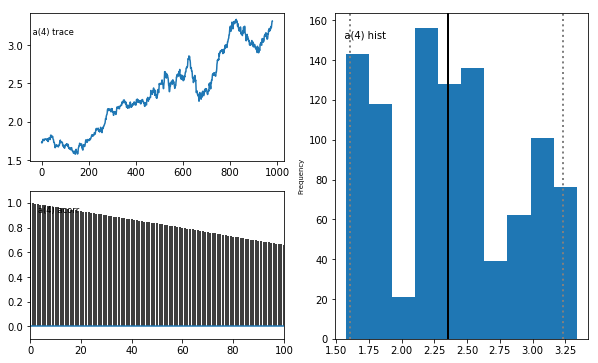

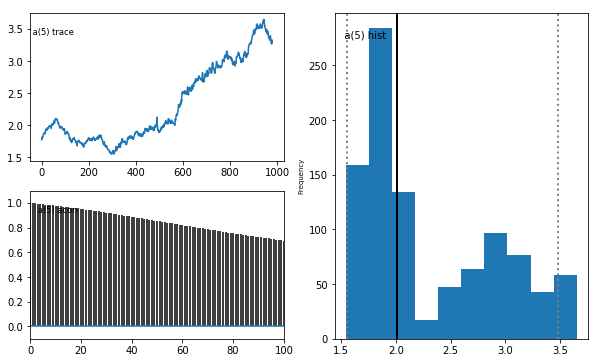

...

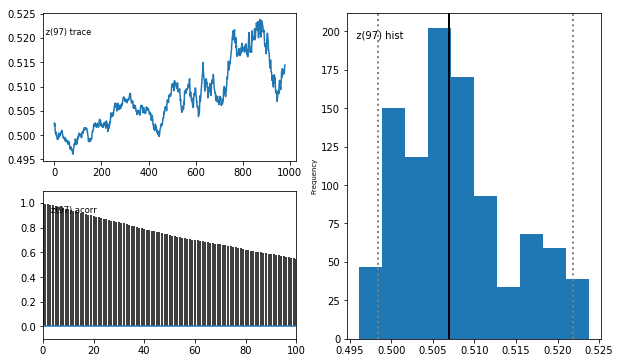

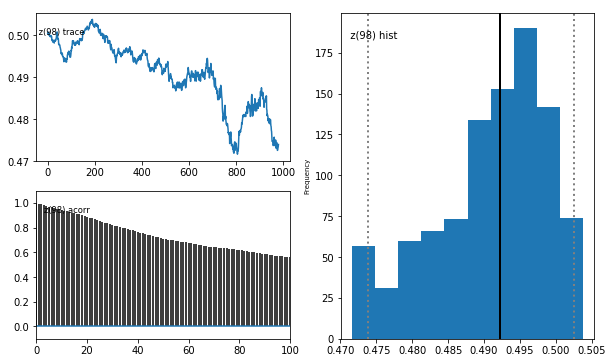

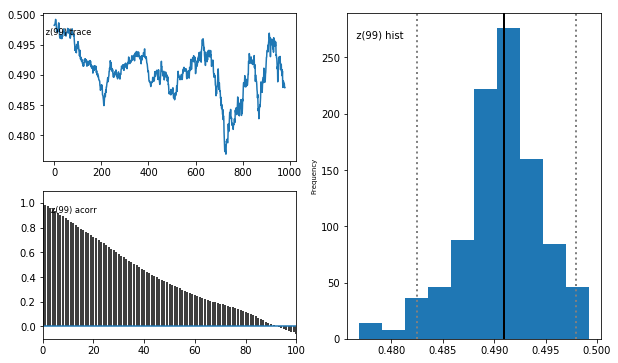

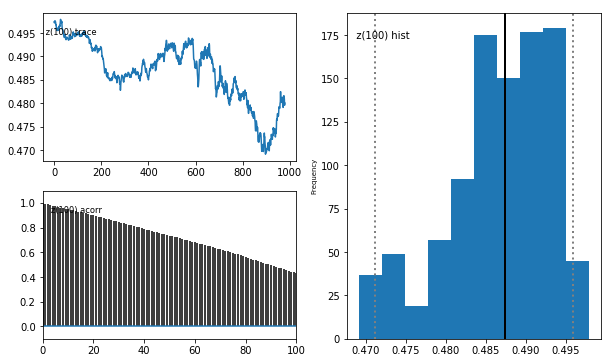

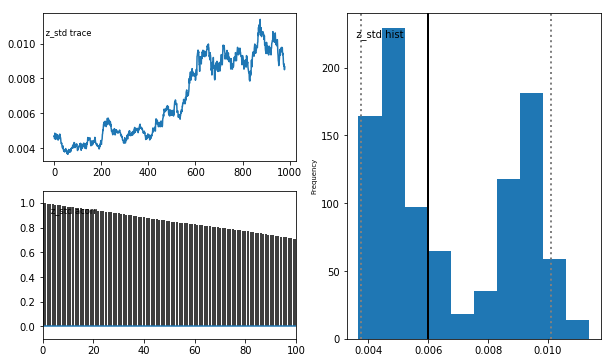

In [412]:
m_weak_s2.plot_posteriors()

In [411]:
stats.to_csv("weak.csv")
stats_f.to_csv("fix.csv")
stats_c.to_csv("chang.csv")

To me, it's important to see the differences between these three games. If you see the first model with all the games included, the a threshold is about 2.94 which IMO doesn't mean anything on its own. But since we learned that the threshold a gives us the perceived difficulty of the game, we can see that the mean threshold for the most difficult game (PD with changing partners) has 3.03 and the easiest one 2.64. Also, in both weak and fixed partners PD the drift rate is positive (for cooperation) and in the changing partners game is negative, towards defection (check this). The t value (which I have to confirm is the non-decision time) is lowest on the weak game wrt the changing and fixed.



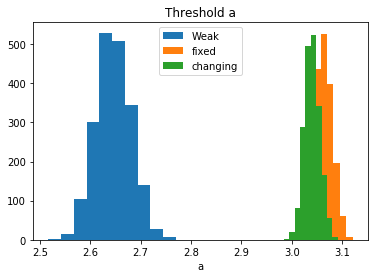

In [258]:
weak_vals = m_weak.get_traces()
fixed_vals = m_fixed.get_traces()
changing_vals = m_changing.get_traces()

plt.hist(weak_vals.a, label = "Weak")
plt.hist(fixed_vals.a, label = "fixed")
plt.hist(changing_vals.a, label = "changing")
plt.title("Threshold a")
plt.xlabel("a")
plt.legend(loc = "best")


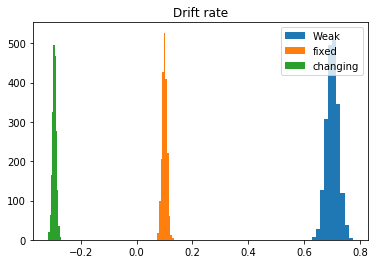

In [259]:
plt.hist(weak_vals.v, label = "Weak")
plt.hist(fixed_vals.v, label = "fixed")
plt.hist(changing_vals.v, label = "changing")
plt.title("Drift rate")
plt.legend(loc = "best")


In [262]:
#m_game = hddm.HDDM(data, depends_on={'a': 'game'})
#m_game.find_starting_values()
#m_game.sample(10000, burn=1000)

#Getting values per round.

#fixed_rounds = hddm.HDDM(fixed, depends_on = {'a': 'round', 'v': 'round', 't': 'round'})
fixed_rounds = hddm.HDDM(fixed, depends_on = {'a': 'round'})
fixed_rounds.find_starting_values()
fixed_rounds.sample(2000, burn = 20)



-13824.7881091
-13824.7599539
 [-----------------100%-----------------] 1000 of 1000 complete in 41.8 sec

In [310]:
changing_rounds = hddm.HDDM(changing, depends_on = {'a': 'round'})
changing_rounds.find_starting_values()
changing_rounds.sample(2000, burn = 20)

-20614.2135459
-20614.1634812
 [-----------------100%-----------------] 2000 of 2000 complete in 105.0 sec

In [311]:
weak_rounds = hddm.HDDM(weak, depends_on = {'a': 'round'})
weak_rounds.find_starting_values()
weak_rounds.sample(2000, burn = 20)

-2551.29063554
-2551.28331296
 [-----------------100%-----------------] 2000 of 2000 complete in 61.6 sec

Text(0,0.5,'a')

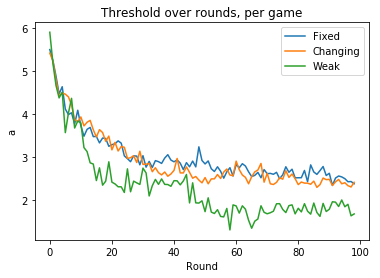

In [314]:
f_stats = fixed_rounds.gen_stats()
c_stats = changing_rounds.gen_stats()
w_stats = weak_rounds.gen_stats()

f_thresholds = list(f_stats["mean"])
c_thresholds = list(c_stats["mean"])
w_thresholds = list(w_stats["mean"])
plt.plot(f_thresholds[0:99], label = "Fixed")
plt.plot(c_thresholds[0:99], label = "Changing")
plt.plot(w_thresholds[0:99], label = "Weak")
plt.legend(loc = "best")
plt.title("Threshold over rounds, per game")
plt.xlabel("Round")
plt.ylabel("a")

In [332]:
f_stats

,mean,std,2.5q,25q,50q,75q,97.5q,mc err
a(1),5.50243,0.309994,4.91166,5.30164,5.49348,5.70128,6.12753,0.0096393
a(2),5.24672,0.282765,4.73922,5.05534,5.23875,5.44139,5.83115,0.00891129
a(3),4.88236,0.267848,4.38968,4.70298,4.88227,5.06001,5.44048,0.00906582
a(4),4.4681,0.2289,4.03626,4.31034,4.4659,4.62089,4.93374,0.00773377
a(5),4.63499,0.230329,4.19307,4.48076,4.63526,4.77902,5.09613,0.00782881
a(6),4.11376,0.198758,3.72855,3.9797,4.1027,4.25081,4.49473,0.00654181
a(7),3.98632,0.199086,3.62134,3.84671,3.9824,4.11996,4.37378,0.00599259
a(8),4.02652,0.189874,3.66135,3.88806,4.02754,4.16219,4.40078,0.00591349
a(9),3.76794,0.174193,3.45038,3.6544,3.76147,3.87814,4.13887,0.00578976
a(10),4.08652,0.208807,3.69004,3.94365,4.08444,4.22309,4.48019,0.00652298


Plotting a(1)
Plotting a(2)
Plotting a(3)
Plotting a(4)
Plotting a(5)
Plotting a(6)
Plotting a(7)
Plotting a(8)
Plotting a(9)
Plotting a(10)
Plotting a(11)
Plotting a(12)
Plotting a(13)
Plotting a(14)
Plotting a(15)
Plotting a(16)
Plotting a(17)
Plotting a(18)
Plotting a(19)
Plotting a(20)
Plotting a(21)
Plotting a(22)


/Users/eladiomontero/opt/anaconda3/envs/decTimesEnv/lib/python2.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Plotting a(23)
Plotting a(24)
Plotting a(25)
Plotting a(26)
Plotting a(27)
Plotting a(28)
Plotting a(29)
Plotting a(30)
Plotting a(31)
Plotting a(32)
Plotting a(33)
Plotting a(34)
Plotting a(35)
Plotting a(36)
Plotting a(37)
Plotting a(38)
Plotting a(39)
Plotting a(40)
Plotting a(41)
Plotting a(42)
Plotting a(43)
Plotting a(44)
Plotting a(45)
Plotting a(46)
Plotting a(47)
Plotting a(48)
Plotting a(49)
Plotting a(50)
Plotting a(51)
Plotting a(52)
Plotting a(53)
Plotting a(54)
Plotting a(55)
Plotting a(56)
Plotting a(57)
Plotting a(58)
Plotting a(59)
Plotting a(60)
Plotting a(61)
Plotting a(62)
Plotting a(63)
Plotting a(64)
Plotting a(65)
Plotting a(66)
Plotting a(67)
Plotting a(68)
Plotting a(69)
Plotting a(70)
Plotting a(71)
Plotting a(72)
Plotting a(73)
Plotting a(74)
Plotting a(75)
Plotting a(76)
Plotting a(77)
Plotting a(78)
Plotting a(79)
Plotting a(80)
Plotting a(81)
Plotting a(82)
Plotting a(83)
Plotting a(84)
Plotting a(85)
Plotting a(86)
Plotting a(87)
Plotting a(88)
Plotting a

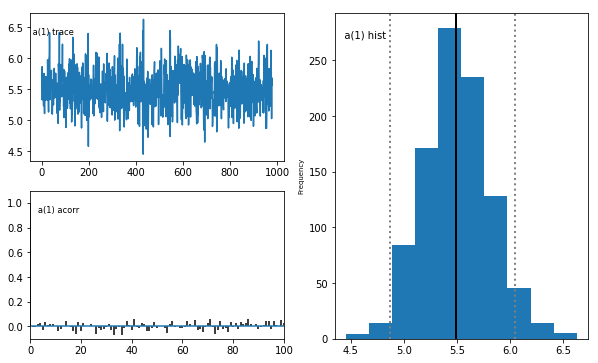

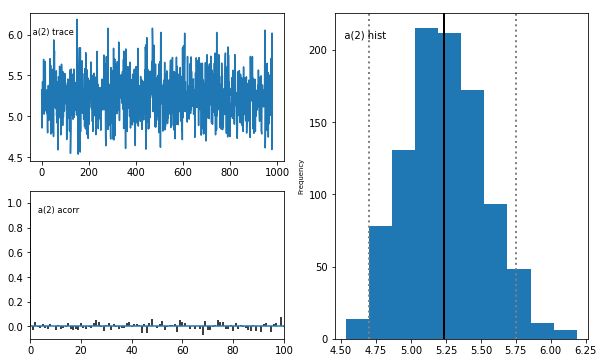

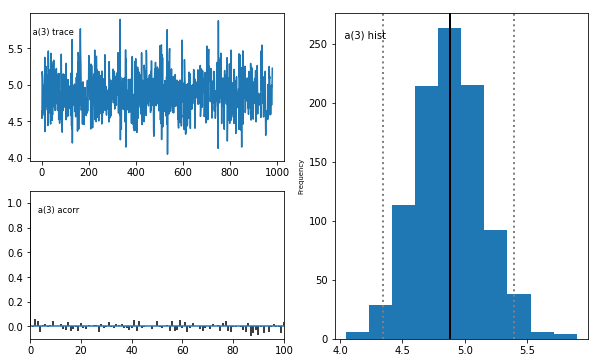

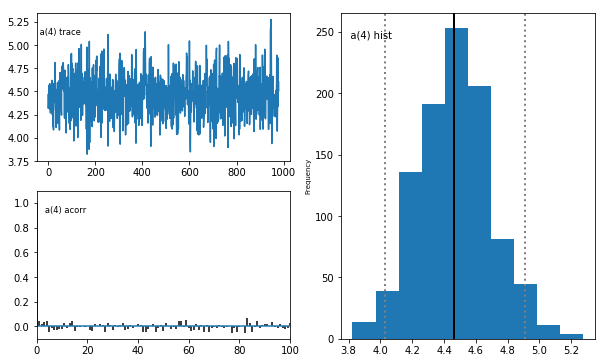

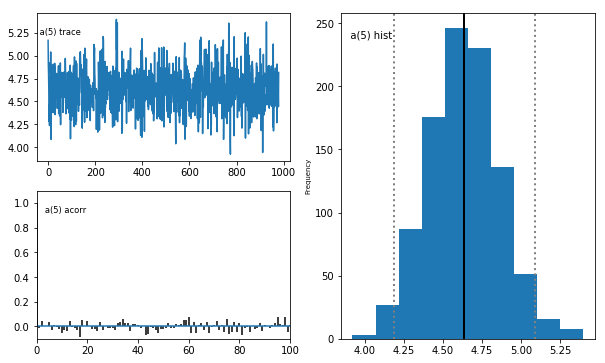

...

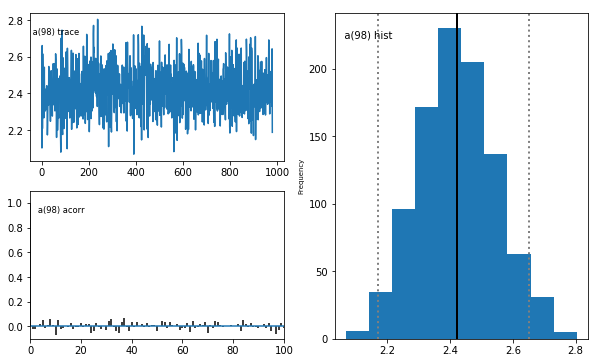

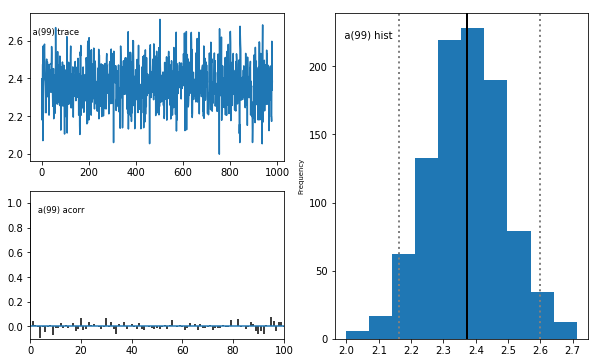

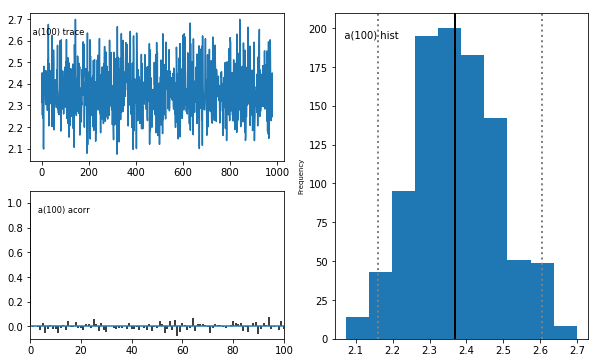

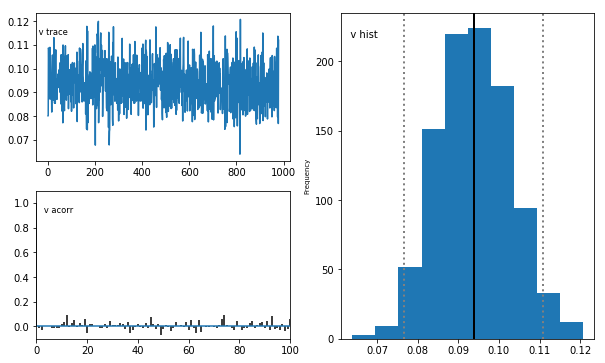

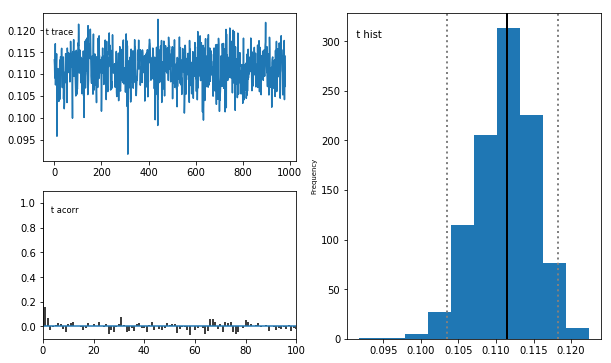

In [315]:
fixed_rounds.plot_posteriors()

Weak PD RT distribution + fitting
Changing partners PD RT distribution + fitting
Fixed PD RT distribution + fitting


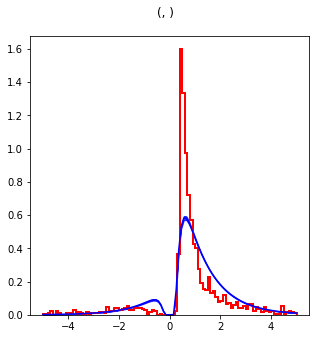

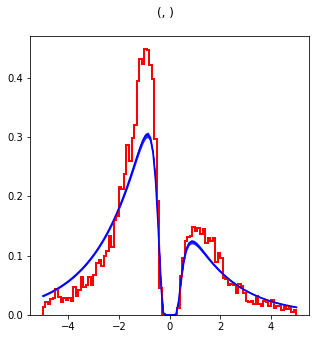

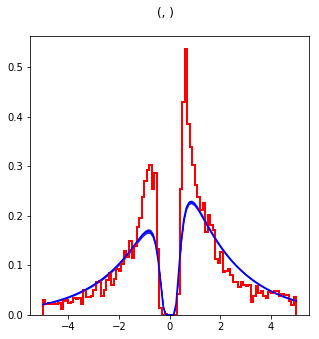

In [331]:
print("Weak PD RT distribution + fitting")
m_weak.plot_posterior_predictive(figsize=(5, 5))
print("Changing partners PD RT distribution + fitting")
m_changing.plot_posterior_predictive(figsize=(5, 5))
print("Fixed PD RT distribution + fitting")
m_fixed.plot_posterior_predictive(figsize=(5, 5))

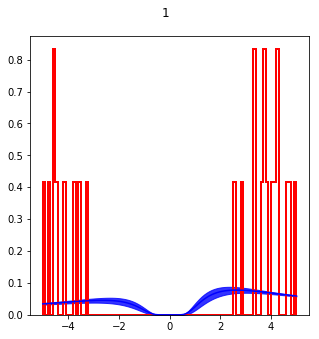

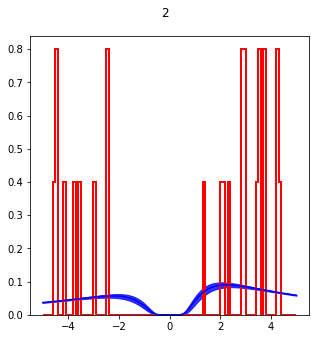

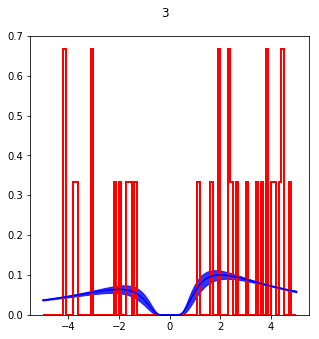

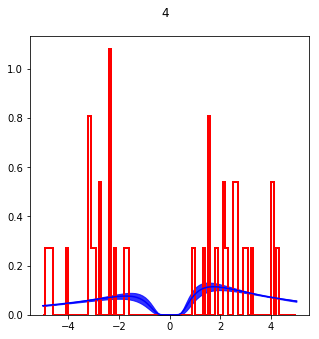

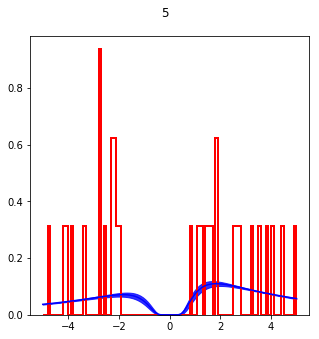

...

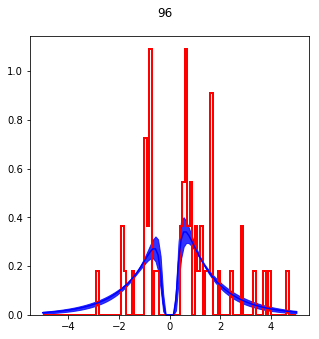

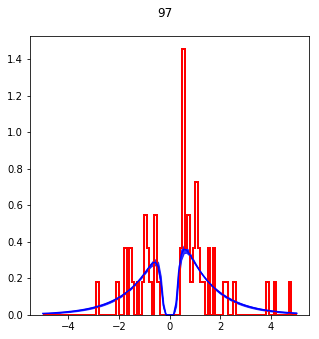

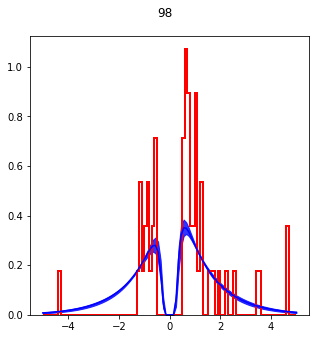

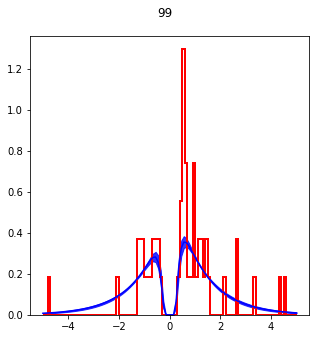

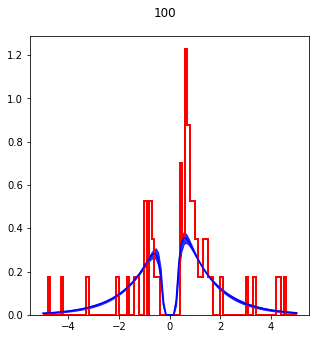

In [329]:
fixed_rounds.plot_posterior_predictive(figsize=(5, 5))

Plotting a
Plotting v
Plotting t


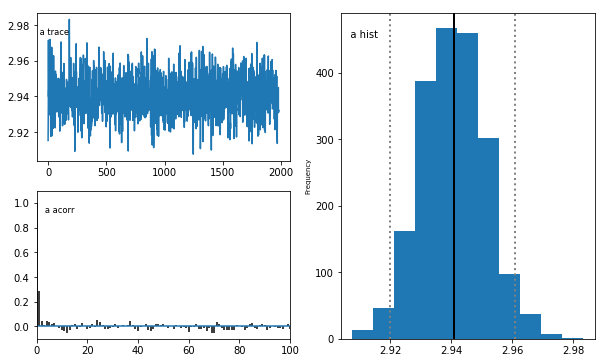

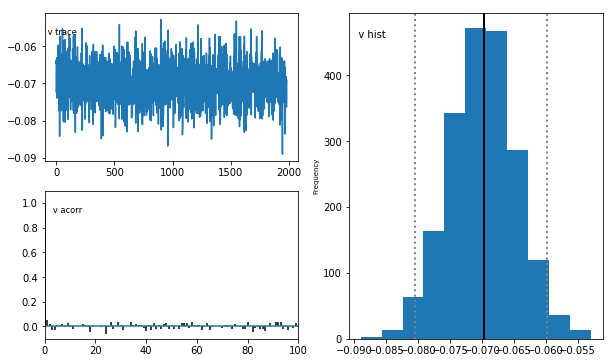

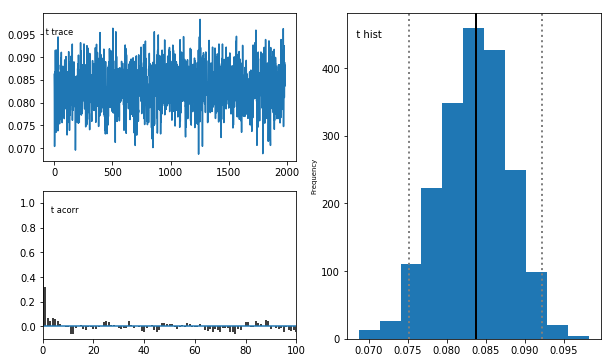

In [23]:
#check convergence
m.plot_posteriors()
#no drifts or large jumps in the trace (non stationary). The autocorrelation is also very low.



In [369]:
#basic model by players
m2 = hddm.HDDM(data2, bias=True, include=('sv', 'st', 'sz'))
# find a good starting point which helps with the convergence.
m2.find_starting_values()
m2.sample(2000, burn=20)
#by player
#m2.plot_posterior_predictive(figsize=(24, 60))
#m2.gen_starts()

 [---               9%                  ] 181 of 2000 complete in 615.1 secHalting at iteration  180  of  2000


KeyboardInterrupt: 

/opt/anaconda3/envs/DecTimesEnv/lib/python2.7/site-packages/matplotlib/axes/_axes.py:6571: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


ValueError: num must be 1 <= num <= 171, not 172

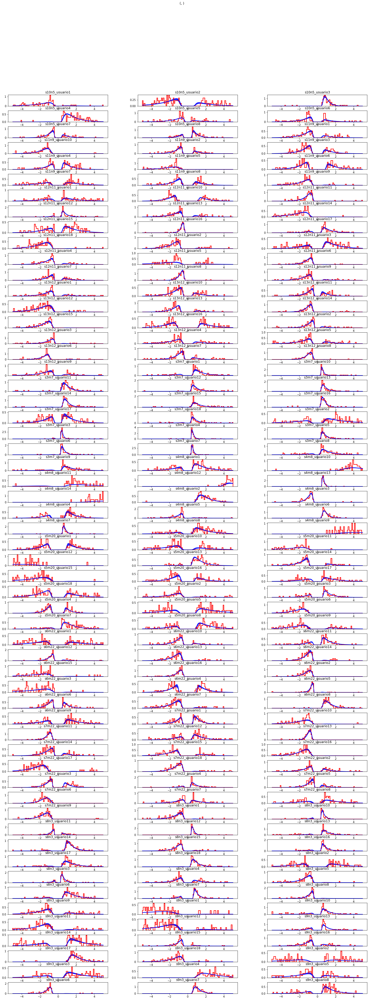

In [35]:
m2.plot_posterior_predictive(figsize=(24, 60))

In [37]:
stats2 = m2.gen_stats()
print(stats2)

                             mean        std       2.5q       25q       50q  \
a                         2.89127  0.0903801    2.71703   2.83014   2.89172   
a_std                     1.15426  0.0914716   0.989923   1.09232   1.14843   
a_subj.s10n5_usuario1     3.33283    0.20202    2.94905   3.20143   3.32748   
a_subj.s10n5_usuario2     3.01022   0.159089    2.71608   2.89929   3.00506   
a_subj.s10n5_usuario3     2.78196   0.429378    2.12658   2.47974   2.70465   
a_subj.s10n5_usuario4     3.57222   0.277703     3.0481   3.37653   3.57374   
a_subj.s10n5_usuario5     2.42519   0.190871    2.06792   2.29508   2.41689   
a_subj.s10n5_usuario6     2.18367   0.160716    1.88785   2.07122   2.17777   
a_subj.s10n5_usuario7     1.81938   0.104738    1.62036   1.74771   1.81857   
a_subj.s10n5_usuario8     1.71715   0.092703    1.55005   1.65168   1.71389   
a_subj.s11n9_usuario1     2.43136   0.139984    2.17636    2.3361   2.42472   
a_subj.s11n9_usuario10    3.76273   0.466274    3.03

In [333]:
m2.get_traces()

NameError: name 'm2' is not defined